## Overview  
This notebook explores the relationship between **electromyography (EMG) signals** and **isometric force production** during directional arm movements. The goal is to preprocess raw EMG data, extract meaningful features, and build predictive models to estimate force components (*X* and *Y*) using machine learning techniques.  

## Dataset  
- **EMG Signals**: Recordings from 7 muscles (`aDEL`, `pDEL`, `lBIC`, `sBIC`, `lTRI`, `BRA`, `mPEC`) sampled at 1000 Hz.  
- **Force Signals**: 2D force (*X*, *Y*) recorded at 100 Hz across 12 movement directions (30° increments), each repeated 4 times.  

In [1]:
import pandas as pd
import numpy as np
import scipy
from scipy.signal import butter, filtfilt, iirnotch, stft, welch


import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

from tqdm import tqdm
from scipy import stats

In [2]:
mat = scipy.io.loadmat('Dataset/Dataset_isometric_task.mat')
D = mat['Dataset'][0,0]

In [3]:
type(D)

numpy.void

The datasets are stored in a MAT file. For each of the 12 directions and of the 4 repetitions we have 8 EMG signals and 2 (x, and y) force signals. 

In [4]:
force_cells  = D['force']['signals'][0,0]
force_fs = int(D['force']['fc_Hz'][0, 0].item())
print("Force Frequency:",force_fs, "Hz")

Force Frequency: 100 Hz


In [5]:
force_cells[0][0].shape

(435, 2)

In [6]:
muscle = D['muscle']
muscle_fields = list(muscle.dtype.names[:-1])

emg_cells = {mus: D['muscle'][mus][0,0] for mus in muscle_fields}

emg_fs = int(D['muscle']['fc_Hz'][0, 0].item())
print("EMG Frequency:",emg_fs, "Hz")


EMG Frequency: 1000 Hz


We extract the EMG and force signals into a dictionary since different repetition/direction signals don't share the length, and the force has a lower sampling frequency.

Our force target is actually divided into an X and a Y component.
We save the values as well as the magnitude.

In [7]:
data = []

for direction in range(12):
    data.append([])
    for repetition in range(4):
        muscle_dict = {}
        for muscle_type in muscle_fields:
            muscle_dict[muscle_type] = emg_cells[muscle_type][direction][repetition].ravel()
            
        muscle_dict["force_x"] = force_cells[direction][repetition][:, 0]
        muscle_dict["force_y"] = force_cells[direction][repetition][:, 1]
        muscle_dict["force_magnitude"] = (muscle_dict["force_x"]**2 + muscle_dict['force_y']**2)**0.5
        muscle_dict["direction"] = direction
        muscle_dict["repetition"] = repetition
        data[-1].append(muscle_dict)
        
        print(f"Direction {direction} - Repetition {repetition}")
        print(f"Number of EMG samples: {len(muscle_dict['BRA'])} ({(len(muscle_dict['BRA']) / emg_fs):.2f} seconds)")
        print(f"Number of force samples: {len(muscle_dict['force_x'])} ({len(muscle_dict['force_x']) / force_fs} seconds)")
        print("----------------------------------------------")

Direction 0 - Repetition 0
Number of EMG samples: 4341 (4.34 seconds)
Number of force samples: 435 (4.35 seconds)
----------------------------------------------
Direction 0 - Repetition 1
Number of EMG samples: 4501 (4.50 seconds)
Number of force samples: 451 (4.51 seconds)
----------------------------------------------
Direction 0 - Repetition 2
Number of EMG samples: 4501 (4.50 seconds)
Number of force samples: 451 (4.51 seconds)
----------------------------------------------
Direction 0 - Repetition 3
Number of EMG samples: 4171 (4.17 seconds)
Number of force samples: 418 (4.18 seconds)
----------------------------------------------
Direction 1 - Repetition 0
Number of EMG samples: 4301 (4.30 seconds)
Number of force samples: 431 (4.31 seconds)
----------------------------------------------
Direction 1 - Repetition 1
Number of EMG samples: 4471 (4.47 seconds)
Number of force samples: 448 (4.48 seconds)
----------------------------------------------
Direction 1 - Repetition 2
Number 

To analyze the EMG visualize we must choose a single trial, ie. a repetition-direction combination. From that we plot each signal.

In [8]:
single_trial = data[0][0]

In [9]:
def plot_signals(ecg, height=1100, width = 1200):
    fig = make_subplots(
    rows=len(muscle_fields), 
    cols=1,
    shared_xaxes=True,
    vertical_spacing=0.02,
)

    colors = ['blue', 'red', 'green', 'purple']

    for i, muscle in enumerate(muscle_fields):
        fig.add_trace(
            go.Scatter(
                x=np.arange(len(ecg[muscle])) / emg_fs,
                y=ecg[muscle],
                line=dict(width=1, color=colors[i % len(colors)])
            ),
            row=i+1, 
            col=1)

    fig.update_layout(
        width=width,
        height=height,
        title_text=f"EMG Signals",
        showlegend=False
    )

    for i, muscle in enumerate(muscle_fields):
        fig.update_yaxes(title_text=f"{muscle} (mV)", row=i+1, col=1)
        
    fig.update_xaxes(title_text=f"Seconds", row=i+1, col=1)    
        
    fig.show()

In [10]:
plot_signals(ecg=single_trial)

We can notice how noisy each signal looks. Considering force is linked to slow variation in muscle activations, most of the high-frequency components that are show here are not very useful for our task.

Another thing we can notice is that every muscle EMG (except the tricepts ones) is vastly different from each other. This is related to EMG being a stochastic signals, without clear cycles and patterns like the ECG.

An interest point is that pDEL seems to have signal saturation, with several segment of the series being capped to a value...

We check the Mean Absolute correlation to not cancel the correlation out when taking the mean.

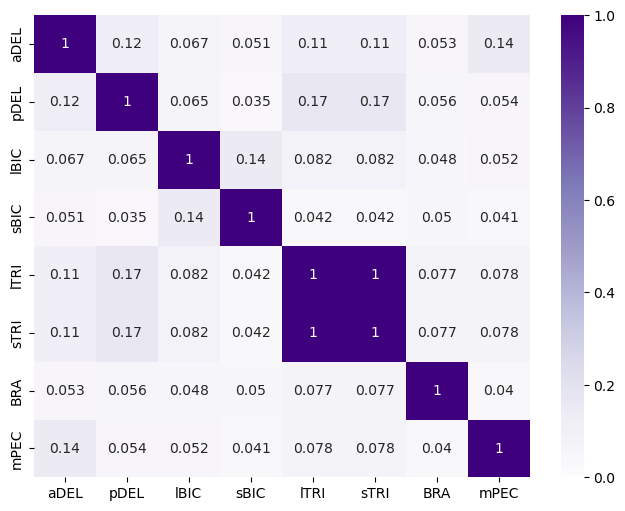

In [11]:
plt.figure(figsize=(8, 6))

corrs = []
for i in range(12):
    for j in range(4):
        tmp = pd.DataFrame(dict((k, data[i][j][k]) for k in muscle_fields))
        corrs.append(tmp.corr().abs())
        
corr_init = sum(corrs) / (12*4)
sns.heatmap(corr_init, cmap="Purples", vmin=0, vmax=1, annot=True);

The correlation matrix is very flat, with a few combinations exceeding 0.1. The tricept muscles have perfect correlation.

In [12]:
check=[]
for i in range(12):
    for j in range(4):
        tmp = data[i][j]
        check.extend((tmp["sTRI"] == tmp["lTRI"]))
np.unique(check)

array([ True])

The EMG of sTRI and lTRI are the same in every direction and repetition.
This confirms what stated in the paper "As it is
difficult to obtain separate EMG recordings for different
portions of the Triceps, we modeled the long (lTRI) and
short heads of the Triceps (sTRI) as two separate muscles
but assumed that they are driven by the same EMG signal".

Since we aren't making a simulation of the muscles, and our models won't care about two identical columns, We'll keep one of them.

In [13]:
muscle_fields.remove("sTRI")
muscle_fields

['aDEL', 'pDEL', 'lBIC', 'sBIC', 'lTRI', 'BRA', 'mPEC']

In [14]:
for i in range(12):
    for j in range(4):
        curr_dict = data[i][j]
        data[i][j] = {k: curr_dict[k] for k in curr_dict.keys() if k!="sTRI"}
print(data[i][j].keys())

dict_keys(['aDEL', 'pDEL', 'lBIC', 'sBIC', 'lTRI', 'BRA', 'mPEC', 'force_x', 'force_y', 'force_magnitude', 'direction', 'repetition'])


Evaluating a preprocessing of signals through visual inspection and the use of convention is typical, but we would like a metric to measure the improvements.
The most famous one is the Signal-to-Noise Ratio (SNR). The formula for this metric changes based on whether the signal is deterministc or stochastic, while the noise is always stochastic. The way to compute it with a stochastic signal is by using the variance of "noise segments" and "signal segments". We have over 300 signals, and we can't manually pick those ranges.
The next function uses the Short-Time Fourier Transform to analyze the signal in the frequency domain over time. The idea is to compute the power spectral density of the signal, estimate the noise using a smoothing function, and calculate the SNR for each time window in the signal.

In [15]:
from scipy.ndimage import minimum_filter1d

def estimate_emg_snr_ms(emg, fs, bp_freq=(20, 450), n_fft=512, win_sec=0.025, hop_sec=0.010, min_window_sec=0.5):

    win_len = int(win_sec * fs)
    hop_len = int(hop_sec * fs)
    f, _, Z = stft(
        emg,
        fs=fs,
        nperseg=win_len,
        noverlap=win_len - hop_len,
        nfft=n_fft,
        boundary=None,
    )

    psd = np.abs(Z) ** 2

    min_win = max(1, int(min_window_sec / hop_sec))
    noise_psd = minimum_filter1d(psd, size=min_win, axis=1, mode='reflect')

    band_bins = np.where((f >= bp_freq[0]) & (f <= bp_freq[1]))[0]
    total_power = psd[band_bins].mean(axis=0)
    noise_power = noise_psd[band_bins].mean(axis=0)

    eps = 1e-12
    snr_lin = np.maximum(total_power - noise_power, eps) / np.maximum(noise_power, eps)


    avg_lin = np.mean(snr_lin)
    return 10.0 * np.log10(avg_lin)

In [16]:
snr_pre = []
for trial in np.array(data).flatten():
    for muscle in muscle_fields:
        snr = estimate_emg_snr_ms(trial[muscle], fs=1000, n_fft=64, win_sec=0.05, hop_sec=0.01)
        snr_pre.append(snr)
    
avg_snr_pre = np.mean(snr_pre)
print(f"Average SNR before preprocessing: {avg_snr_pre:.3f}")

Average SNR before preprocessing: 17.676


We create a function to analyze the frequency content of a signal.

First we convert it to the Frequency Domain using FFT, then we optionally plot the spectrum.

In [17]:
from scipy.fft import fft, fftfreq

def frequency_domain(signal, fs = 1000, plot=True, muscle_name="", vlines=None):
    n = len(signal)
    x = fftfreq(len(signal), 1/fs)[:n//2]
    y = fft(signal)
    
    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x, np.abs(y[:n//2]))
        plt.title(f"{muscle_name} EMG Frequency Spectrum")
        plt.xlabel("Frequency [Hz]")
        plt.ylabel("Magnitude")
        for x in vlines:
            plt.axvline(x=x,linestyle="--", c="r", alpha=0.5)
        plt.grid()
        plt.show()
    return x, y

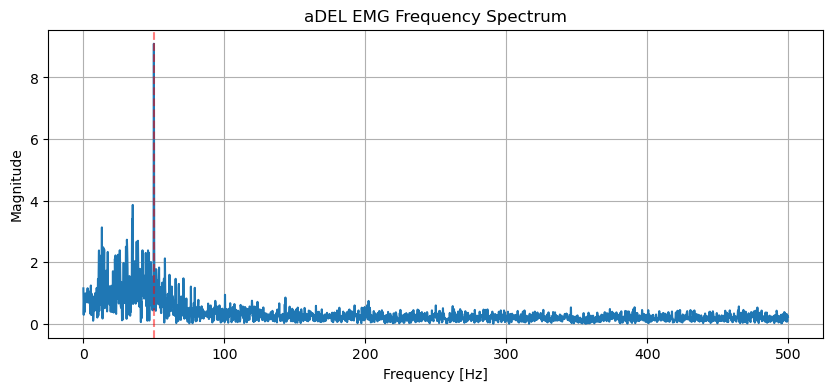

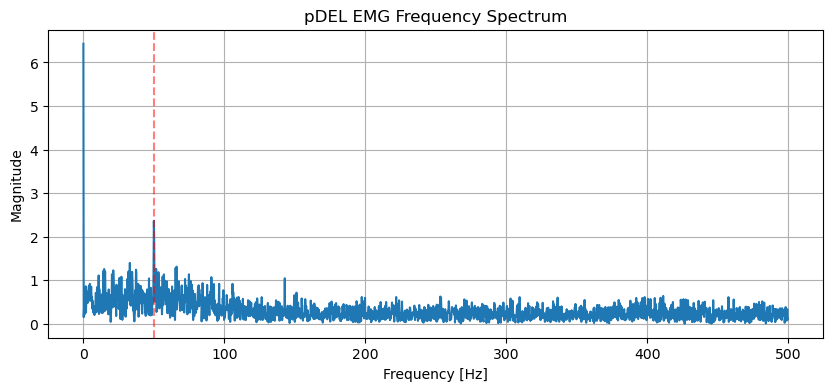

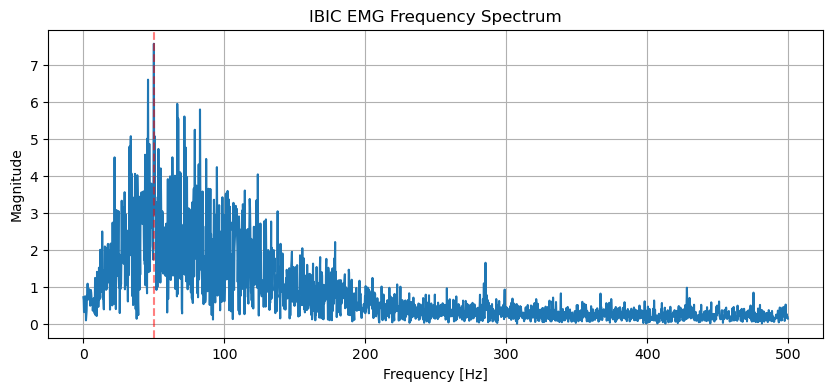

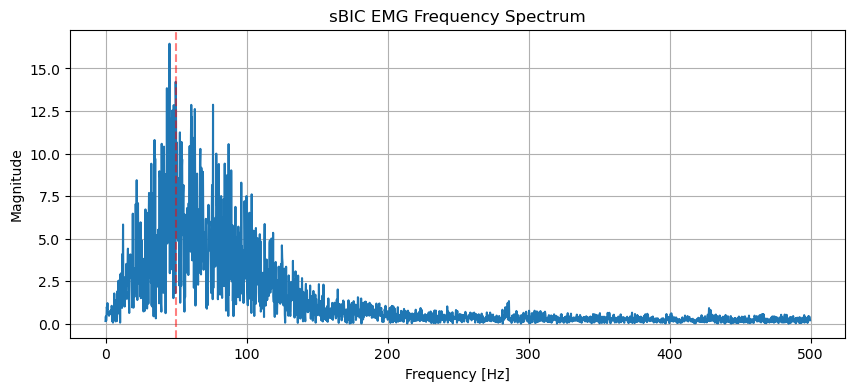

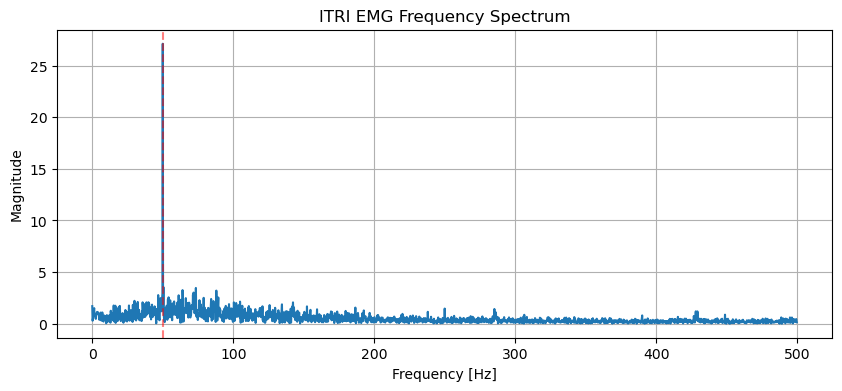

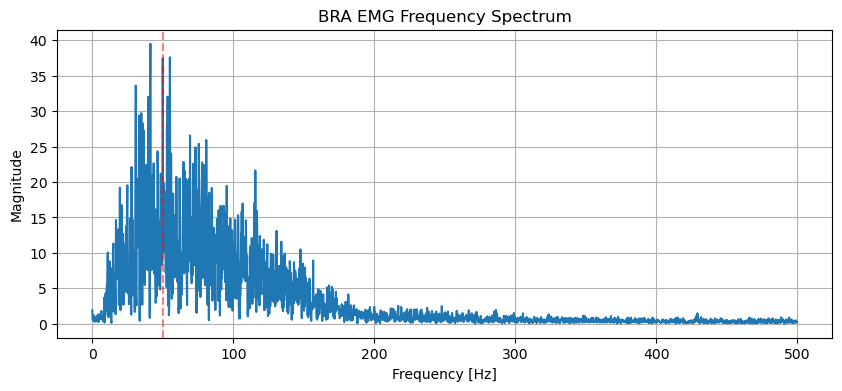

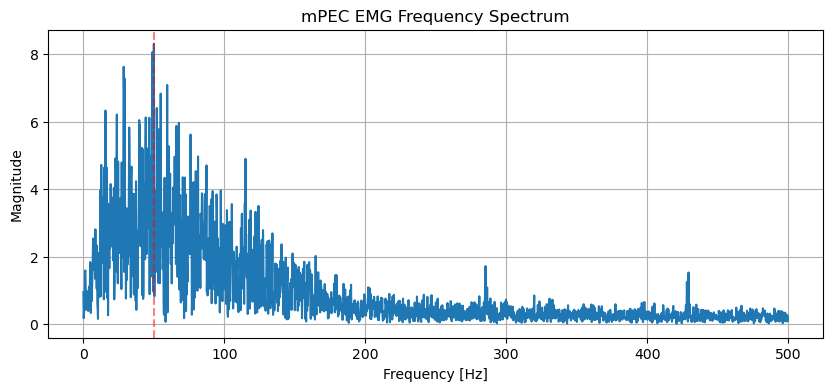

In [18]:
[frequency_domain(single_trial[muscle], muscle_name=muscle, vlines=[50]) for muscle in muscle_fields];

In many muscle spectra we can notice that there is a sudden spike (most noticeable in aDEL and lTRI), an outlier, at 50 Hz: likely Powerline Interference.
Each signal seems to be dominated mostly by frequencies.

The x-axis goes from 0 to the nyquist frequency $(\frac{fs}{2})$ since it's the highest that can be represented without causing aliasing.

### Preprocessing

In [19]:
from copy import deepcopy

def transform_signals(data, func, muscles_to_target=None):
    processed_data = deepcopy(data)
    
    if muscles_to_target is None:
        muscles_to_target = muscle_fields

    for direction in tqdm(range(12)):
        for repetition in range(4):
            for muscle in muscles_to_target:
                current = processed_data[direction][repetition][muscle]
                transformed = func(current)
                processed_data[direction][repetition][muscle] = transformed
    return processed_data

We created a function that will apply another, a transformation, to every EMG signal. This will be used to filter and to do the rest of the preprocessing methods.

Now we will start filtering the data.


First, we know that EMG signal content if found in frequencis between 20 and 500 Hz. The usual filter we do with EMG is a bandpass filter. Since our current Nyquist Frequency is fs/2=1000/2=500, we must lower the high-cut (eg. 450).
A bandpass filters passes frequencies found in the given band and attenuates frequencies outside of it.
These filters are usually implemented with a Butterworth filter.

In [20]:
def bandpass_filter(signal, low=20, high=500, fs=1000, order=4):
    nyq_f = fs*0.5
    b, a = butter(order, [low/nyq_f, high/nyq_f], btype="bandpass")
    return filtfilt(b, a, signal)

The order determines the sharpness of the filter trasnsitions, we'll choose a relatively low one.

In [21]:
bandpass_data = transform_signals(data, func=lambda signal: bandpass_filter(signal, low=20, high=450, fs=1000, order=10))

100%|██████████| 12/12 [00:00<00:00, 80.16it/s]


In [22]:
# plot_signals(ecg=bandpass_data[0][0]);

We noticed a spike at 50 Hz in the spectrum of some muscles, this is likely due to Powerline Interference or other external types of noise.

We apply a Notch filter, which attenuates frequencies in the given band, to handle that.

In [23]:
def notch_filter(signal, notch_freq, fs=1000, Q=30):
    nyq_f = fs*0.5
    w0 = notch_freq / nyq_f
    b, a = iirnotch(w0, Q)
    return filtfilt(b, a, signal)

In [24]:
notch_data = transform_signals(bandpass_data, lambda signal: notch_filter(signal, notch_freq=50, fs=1000, Q=30), muscles_to_target=muscle_fields)

100%|██████████| 12/12 [00:00<00:00, 257.88it/s]


We check the average SNR after the preprocessing done, it doesn't make sense to calculate after the next transformations as they will modify the signal more aggressively, without just filtering out noise.

In [25]:
snr_post = []
for trial in np.array(notch_data).flatten():
    for muscle in muscle_fields:
        snr = estimate_emg_snr_ms(trial[muscle], fs=1000, n_fft=64, win_sec=0.05, hop_sec=0.01)
        snr_post.append(snr)
    
avg_snr_post = np.mean(snr_post)
print(f"Average SNR before preprocessing: {avg_snr_pre:.3f}")
print(f"Average SNR after preprocessing: {avg_snr_post:.3f}")

Average SNR before preprocessing: 17.676
Average SNR after preprocessing: 18.372


In [26]:
print((np.array(snr_post) > np.array(snr_pre)).sum() / len(snr_pre))

0.6785714285714286


The SNR is higher, not by much but it's still an upgrade. Almost 70% of the single trials have an higher value.

Next we do a common step in EMG preprocessing specifically, rectifying. This step involved removing the negative values of a signal by setting them to 0 (Half-Wave) or to theur absolute value (Full Wave).

Since EMG is a zero-mean signal, this step is done to prevent the signal to balance out when computing certain statistics, reducing the noise, finding features and more. This also helps in showing the intensity(amplitude) of a a EMG burst.

We will apply Full Wave rectification to not lose information, we turn every negative value to positive.

In [27]:
rectified_data = transform_signals(notch_data, func=np.abs)

100%|██████████| 12/12 [00:00<00:00, 4793.03it/s]


Lastly we need to make the 100 Hz force match with our 1000 Hz EMGs, thus we will downsample the latter.

To our signal downsample our signal we need to account for the Nyquist-Shannon sampling theorem applied to downsampling, ie. we need to make sure that our signal doesn't have frequency content over the new Nyquist frequency, half of the new fs. 

So we need to low-pass the signal with a low cut off of at least 50 Hz.

In [28]:
def lowpass_filter(signal, cutoff=50, fs=1000, order=4):
    nyq_f = fs*0.5
    b, a = butter(order, cutoff/nyq_f, btype="lowpass")
    return filtfilt(b, a, signal)

In particular we will smooth the signal with a lower cutoff, to extract an Activation Envelope. It's a signal with low frequency that describes how activate a muscle is, while being smooth still.
This is helpful as it directly models force, which is related to low-frequency waves.


This can be also done with different types of smoothing that we'll address later.

In [29]:
envelope_data = transform_signals(rectified_data, func=lambda signal: lowpass_filter(signal, cutoff=10, fs=1000, order=4))

100%|██████████| 12/12 [00:00<00:00, 152.34it/s]


In [30]:
downsampled_data = transform_signals(envelope_data, func=lambda signal: scipy.signal.decimate(signal, q=10, ftype='iir', zero_phase=True))

100%|██████████| 12/12 [00:00<00:00, 42.45it/s]


Finally we downsample the signal by decimating, ie. taking every 10th sample, after applying an anti aliasing filter.

In [31]:
plot_signals(downsampled_data[0][0]);

We noticed that the new signals are much smoother than they were before as we have attenuated the high frequencies.
Again, while information was lost compared to the initial signals, a lot of noise was too, and for our specific case we care about this slowly changing signal. The signals look promising.

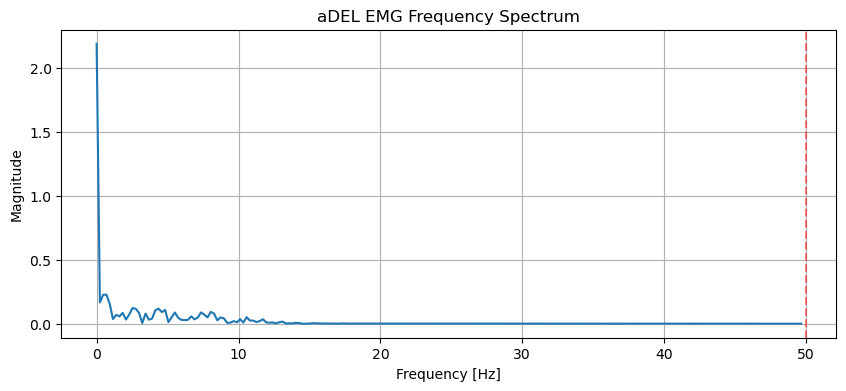

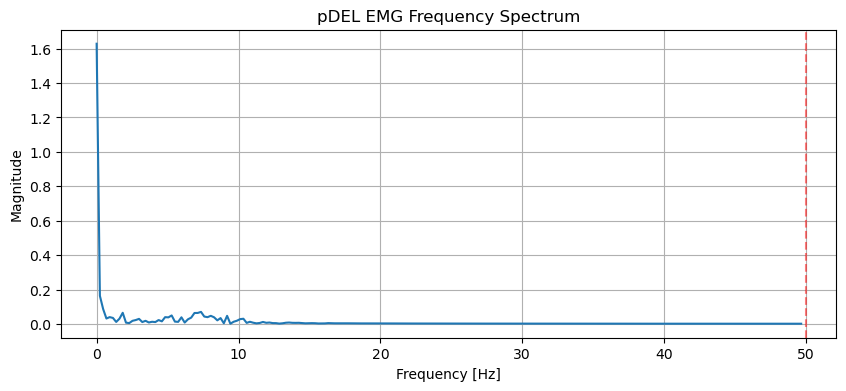

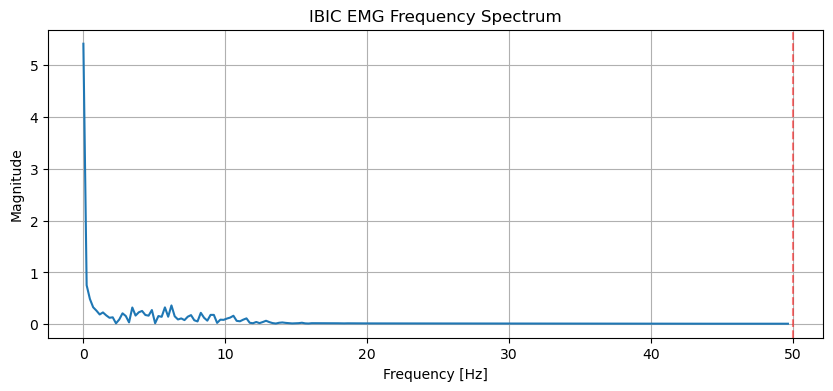

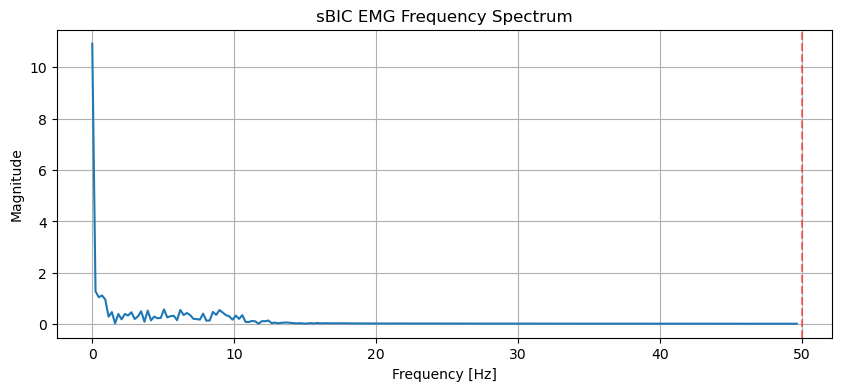

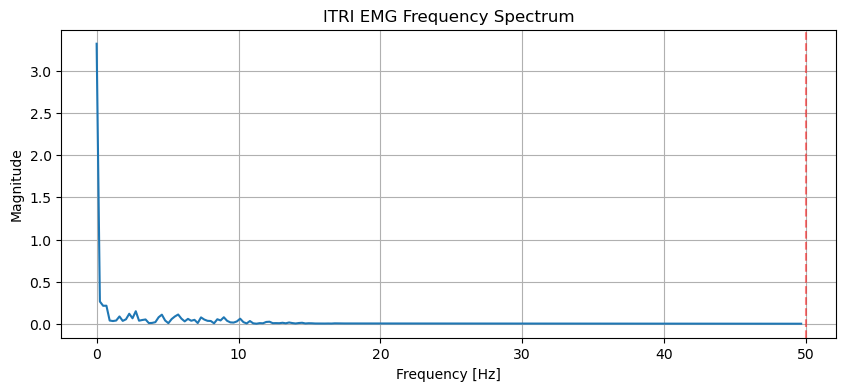

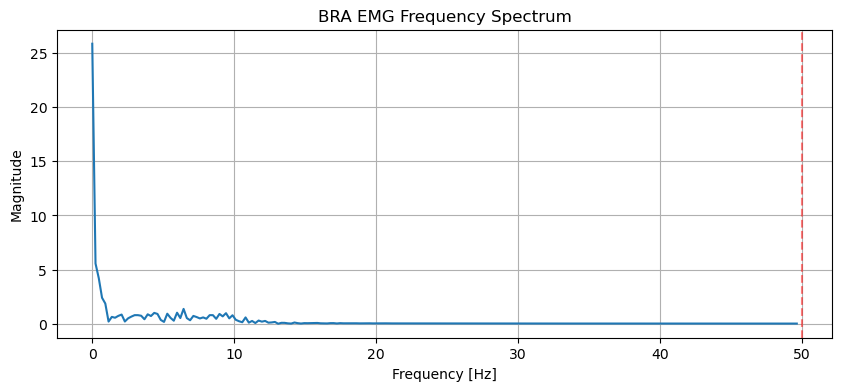

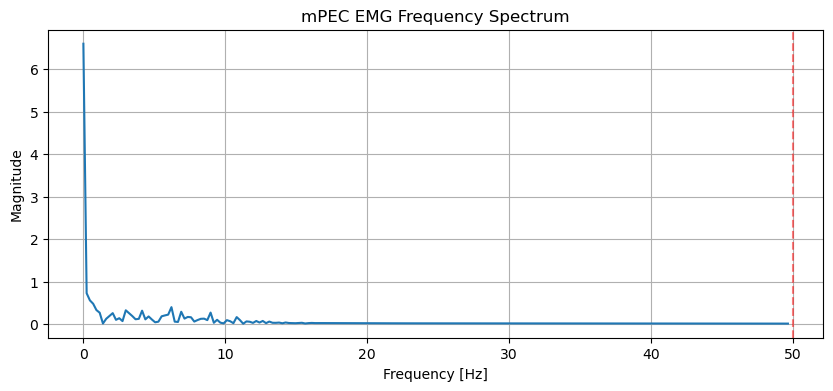

In [32]:
tmp = [frequency_domain(downsampled_data[0][0][muscle], fs=100, muscle_name=muscle, vlines=[50]) for muscle in muscle_fields][0]

In [33]:
len(downsampled_data[0][0]["force_x"]), len(downsampled_data[0][0]["BRA"])

(435, 435)

Since now the EMGs have the same length as their force array, we can create a dataframe for each combination of direction and repetition.

In [34]:
df_list = [pd.DataFrame(downsampled_data[i][j]) for i in range(12) for j in range(4)]

In [35]:
df_list[0].head(2)

,aDEL,pDEL,lBIC,sBIC,lTRI,BRA,mPEC,force_x,force_y,force_magnitude,direction,repetition
0,0.001888,0.000620,0.000958,0.000576,0.002296,0.000151,-0.000159,-0.865295,0.283107,0.910431,0,0
1,0.002324,0.001944,0.002574,0.002020,0.004190,0.002882,0.001318,-0.831443,0.264498,0.872500,0,0


In [36]:
print(sum(df.isna().sum().sum() for df in df_list))

0


We check the again Mean Absolute correlation.

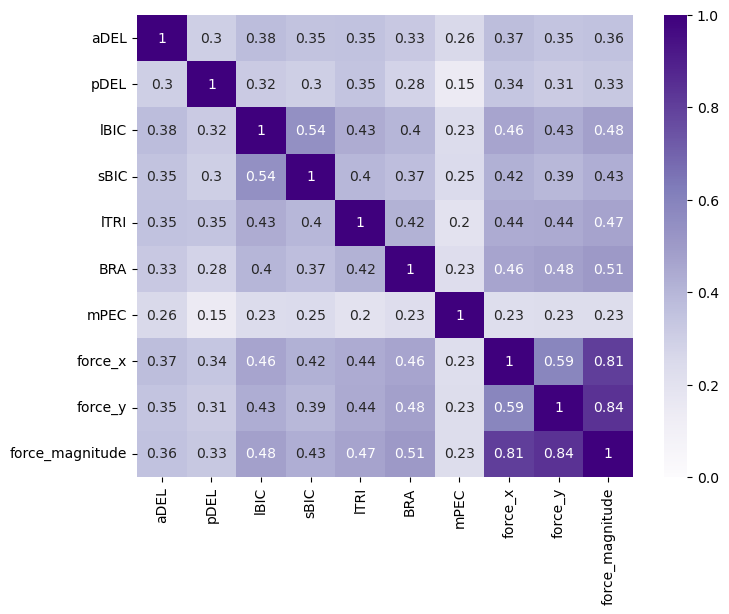

In [37]:
plt.figure(figsize=(8, 6))
corr = sum(df.iloc[:, :-2].corr(method="spearman").abs() for df in df_list) / len(df_list)
sns.heatmap(corr, cmap="Purples", vmin=0, vmax=1, annot=True);

This is a much richer correlation matrix. The areas with the most correlation are the two bands that include the targets, meaning that the signals should be  quite helpful in predicting them. Although there are significant values also among the muscles (meaning they bring similar information), they are lower compared to the ones with the target.

This is promising as the original matrix was sparse, it means that the changes we made gave us a good summary of the relevant aspects of the signals and now they are more informative in general.

In [38]:
df1 = df_list[0]

In [39]:
fig = make_subplots(
    rows=3, 
    cols=1,
    shared_xaxes=False,
    subplot_titles=("Force x", "Force y", "Force magnitude"),
    vertical_spacing=0.09
)

fig.add_trace(
    go.Scatter(y=df1["force_x"], line=dict(width=1)), 
    row=1, col=1)

fig.add_trace(
    go.Scatter(y=df1["force_y"],line=dict(width=1)),
            row=2, col=1)

fig.add_trace(
    go.Scatter(y=df1["force_magnitude"], line=dict(width=1)),
            row=3, col=1)

fig.update_layout(
        width=800,
        height=800,
        title_text=f"Force Signals",
        showlegend=False)

We notice that the force components look fairly similar, quickly decreasing near the begininng to then reach a plateau. However we can notice that Y is more noisy and the line isn't really flat after 100, but keeps decreasing.

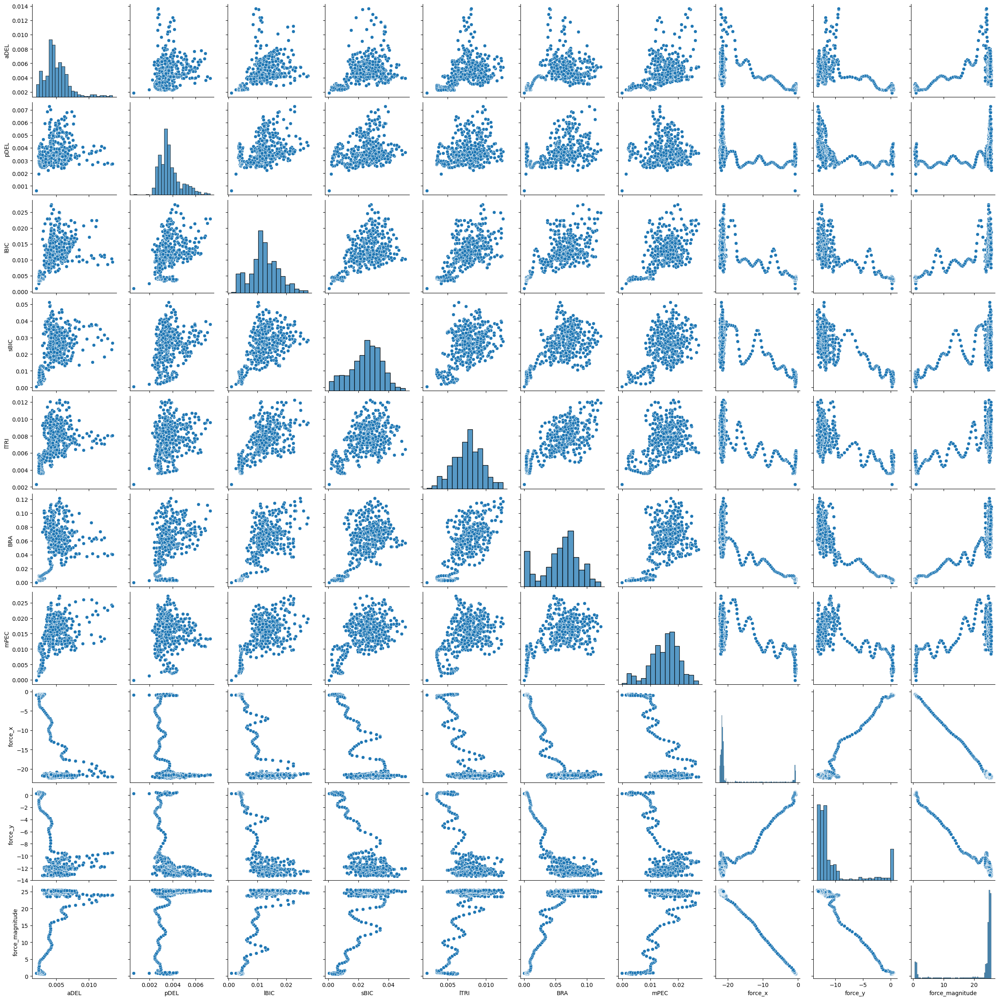

In [40]:
sns.pairplot(df1.drop(["direction","repetition"], axis=1));

### Feature Extraction and Dimensionality Reduction

#### Dimensionality Reduction of EMGs

To plot the distribution of our processed EMG, we'd like to use dimensionality reduction techniques, and we'll apply them after merging the dataset to see if there is a common underlying structure.

In [41]:
merged_df = pd.concat(df_list).reset_index(drop=True)
X = merged_df.iloc[:, :-5]
force_x = merged_df["force_x"]
force_y = merged_df["force_y"]
X.columns

Index(['aDEL', 'pDEL', 'lBIC', 'sBIC', 'lTRI', 'BRA', 'mPEC'], dtype='object')

In [42]:
import pickle

with open("merged_df.pkl", "wb") as file:
    pickle.dump(merged_df, file)

In [43]:
from sklearn.preprocessing import StandardScaler

Before passing the data to PCA we must standardize the data (to get zero-mean and unit-variance). Without this step the PCA components' loadings will be dominated by the features with the highest variance.

In [44]:
scaler = StandardScaler().fit(X)
X_scaled = pd.DataFrame(scaler.transform(X), columns=scaler.get_feature_names_out())

In [45]:
pca = PCA(n_components=2).fit(X_scaled)
pca_comps_raw = pca.transform(X_scaled)
# tsne_comps_raw = TSNE(n_components=2, perplexity=120).fit_transform(X_scaled)

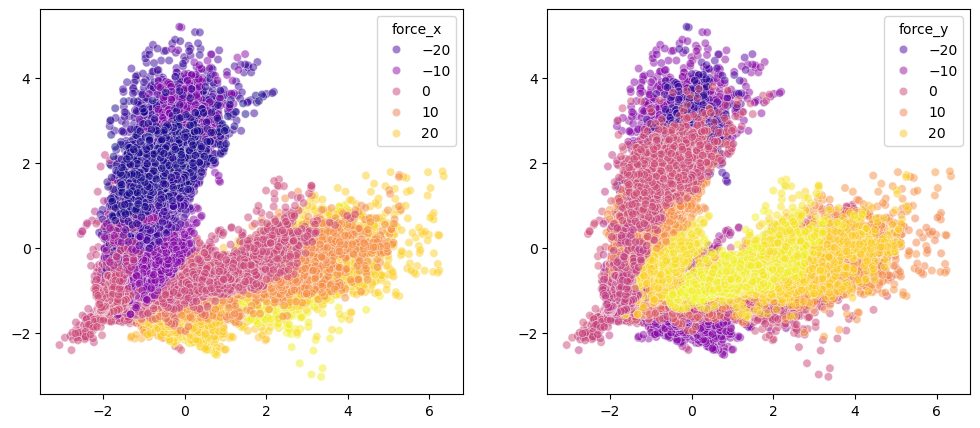

In [46]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
sns.scatterplot(x=pca_comps_raw[:, 0], y=pca_comps_raw[:, 1], hue=force_x, alpha=0.5, palette="plasma", ax=ax1)
sns.scatterplot(x=pca_comps_raw[:, 0], y=pca_comps_raw[:, 1], hue=force_y, alpha=0.5, palette="plasma", ax=ax2);

Althought there is significant overlap the colors does seem to be changing relatively smoothly, in X better than Y.

In [47]:
for i, comp in enumerate(pca.components_, start=1):
    print(f"PC{i} top features:")
    idxs = comp.argsort()[::-1][:5]
    for ind in idxs:
        print(f"{X.columns[ind]}: {comp[ind]}")
    print()

PC1 top features:
lTRI: 0.5239954854094805
lBIC: 0.5121137612176953
pDEL: 0.4020475614649063
aDEL: 0.38839841527444263
sBIC: 0.3490855318587593

PC2 top features:
mPEC: 0.5498679669420523
BRA: 0.5212875852740328
sBIC: 0.46053557182984123
aDEL: 0.23656722053267515
lBIC: 0.16454135022788346



The components have dense loadings with different features which is quite good. If one feature dominated a component's loadings the result would have been unreliable.

In [48]:
# fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
# sns.scatterplot(x=tsne_comps_raw[:, 0], y=tsne_comps_raw[:, 1], hue=force_x, alpha=0.5, palette="plasma", ax=ax1)
# sns.scatterplot(x=tsne_comps_raw[:, 0], y=tsne_comps_raw[:, 1], hue=force_y, alpha=0.5, palette="plasma", ax=ax2);

The plot confirms the previous conclusions, there seem to be some type of structure in the data distributes the force components quite well. In the t-SNE the "clusters" seem even more apparent than PCA, with much less overlap.

#### Spatial Distribution Analysis

We wish to study the activation of the muscles based on the direction.

In [49]:
mean_activation_by_direction = merged_df.groupby('direction')[muscle_fields].mean().reset_index()
angles = np.arange(0, 360, 30)
theta = np.append(angles, angles[0])

# Normalization
normalized_data = mean_activation_by_direction.copy()
for muscle in muscle_fields:
    max_val = mean_activation_by_direction[muscle].max()
    if max_val > 0:
        normalized_data[muscle] = mean_activation_by_direction[muscle] / max_val

# Dominant directions
dominant_dirs = {
    muscle: angles[np.argmax(normalized_data[muscle])]
    for muscle in muscle_fields
}

In [50]:
fig = go.Figure()

for muscle in muscle_fields:
    r_values = mean_activation_by_direction[muscle].tolist()
    r_values.append(r_values[0])
    fig.add_trace(go.Scatterpolar(
        r=r_values,
        theta=theta,
        mode='lines+markers',
        name=muscle,
    ))

fig.update_layout(
    title='Mean Muscle Activation Across Directions (not normalized)',
    polar=dict(
        radialaxis=dict(
            visible=True,
            range=[0, mean_activation_by_direction.loc[:, muscle_fields].max().max() * 1.1]
        ),
        angularaxis=dict(
            tickvals=angles,
            ticktext=[f"{d}°" for d in angles],
            direction="clockwise"
        )
    ),
    showlegend=True,
    template="plotly_dark"
)

fig.show()

In [51]:
subplot_titles = []
for muscle in muscle_fields:
    subplot_titles.extend([f"{muscle} - Directional", f"{muscle} - Histogram"])

# --- Create Subplots ---
rows = len(muscle_fields)
fig = make_subplots(
    rows=rows, cols=2,
    specs=[[{'type': 'polar'}, {'type': 'xy'}] for _ in range(rows)],
    subplot_titles=subplot_titles
)

for i, muscle in enumerate(muscle_fields):
    r_values = normalized_data[muscle].tolist() + [normalized_data[muscle].iloc[0]]
    color=px.colors.qualitative.Plotly[i % len(px.colors.qualitative.Plotly)]

    # Polar Plot (left)
    fig.add_trace(go.Scatterpolar(
        r=r_values,
        theta=theta,
        fill='toself',
        name=muscle,
        showlegend=False,
        line=dict(color=color),
    ), row=i+1, col=1)

    # Histogram (right)
    fig.add_trace(go.Histogram(
        x=merged_df[muscle],
        name=muscle,
        marker=dict(color=px.colors.qualitative.Plotly[i % len(px.colors.qualitative.Plotly)]),
        opacity=0.7,
        nbinsx=20,
        showlegend=False
    ), row=i+1, col=2)

# Layout
fig.update_layout(
    height=250 * len(muscle_fields),
    width=1000,
    title="Directional Activation (Left) + Histogram (Right) per Muscle",
    template="plotly_dark"
)

# Polar axis settings
for i in range(len(muscle_fields)):
    polar_key = f"polar{i+1}" if i > 0 else "polar"
    fig.update_layout(**{
        f"{polar_key}.radialaxis": dict(range=[0, 1], showticklabels=False),
        f"{polar_key}.angularaxis": dict(tickvals=angles, direction='clockwise')
    })

fig.show()

In [52]:
print("Dominant Direction (degrees) for each muscle:")
for muscle, direction in dominant_dirs.items():
    print(f"{muscle}: {direction}°")

Dominant Direction (degrees) for each muscle:
aDEL: 180°
pDEL: 150°
lBIC: 210°
sBIC: 30°
lTRI: 210°
BRA: 0°
mPEC: 330°


In [53]:
muscle_stats = pd.DataFrame({
    'Mean': merged_df.loc[:, muscle_fields].mean(),
    'Median': merged_df.loc[:, muscle_fields].median(),
    'Std Dev': merged_df.loc[:, muscle_fields].std(),
    'Max': merged_df.loc[:, muscle_fields].max(),
    'Dominant Direction': pd.Series(dominant_dirs)
}).sort_values('Mean', ascending=False)

# Create a figure with two subplots
fig = make_subplots(
    rows=1, cols=2,
    specs=[[{"type": "table"}, {"type": "xy"}]],
    subplot_titles=["Muscle Statistics", "Distribution vs Dominant Direction"]
)

# Add table
fig.add_trace(
    go.Table(
        header=dict(
            values=["Muscle"] + list(muscle_stats.columns),
            align="left",
            font=dict(size=12)
        ),
        cells=dict(
            values=[muscle_stats.index] + [muscle_stats[col].round(3) for col in muscle_stats.columns],
            align="left",
            font=dict(size=11)
        )
    ),
    row=1, col=1
)

# Add scatter plot of mean activation vs dominant direction
fig.add_trace(
    go.Scatter(
        x=list(dominant_dirs.values()),
        y=[merged_df[muscle].mean() for muscle in muscle_fields],
        mode='markers+text',
        text=muscle_fields,
        textposition="top center",
        marker=dict(size=12, color=list(range(len(muscle_fields))), colorscale='Viridis'),
        name='Mean vs Direction'
    ),
    row=1, col=2
)

fig.update_layout(
    height=500,
    width=1200,
    title_text="Muscle Distribution Analysis and Dominant Directions",
    template="plotly_dark",
    showlegend=False
)

fig.update_xaxes(title_text="Dominant Direction (degrees)", row=1, col=2)
fig.update_yaxes(title_text="Mean Activation", row=1, col=2)

fig.show()

# Print key insights
print("\nKey Insights:")
for muscle in muscle_fields:
    direction = dominant_dirs[muscle]
    mean_val = merged_df[muscle].mean()
    std_val = merged_df[muscle].std()
    cv = std_val / mean_val if mean_val > 0 else 0
    
    print(f"- {muscle}: Dominant at {direction}°, mean activation {mean_val:.3f}, " +
          f"coefficient of variation {cv:.3f}")
    
    # Additional insights based on directional patterns
    direction_cat = ""
    if 315 <= direction or direction < 45:
        direction_cat = "anterior (forward)"
    elif 45 <= direction < 135:
        direction_cat = "lateral (rightward)"
    elif 135 <= direction < 225:
        direction_cat = "posterior (backward)"
    else:
        direction_cat = "medial (leftward)"
    
    print(f"  Primary activation: {direction_cat}")


Key Insights:
- aDEL: Dominant at 180°, mean activation 0.005, coefficient of variation 0.380
  Primary activation: posterior (backward)
- pDEL: Dominant at 150°, mean activation 0.019, coefficient of variation 1.140
  Primary activation: posterior (backward)
- lBIC: Dominant at 210°, mean activation 0.015, coefficient of variation 0.756
  Primary activation: posterior (backward)
- sBIC: Dominant at 30°, mean activation 0.022, coefficient of variation 0.745
  Primary activation: anterior (forward)
- lTRI: Dominant at 210°, mean activation 0.025, coefficient of variation 1.043
  Primary activation: posterior (backward)
- BRA: Dominant at 0°, mean activation 0.017, coefficient of variation 1.018
  Primary activation: anterior (forward)
- mPEC: Dominant at 330°, mean activation 0.008, coefficient of variation 0.811
  Primary activation: anterior (forward)


- Our results show a clear pattern in how different muscles are activated depending on movement direction, which gives us insight into how they each contribute to generating torque during arm movements.

- Muscles like the anterior deltoid (aDEL), posterior deltoid (pDEL), long head of the biceps (lBIC), and long head of the triceps (lTRI) were most active when movements were directed backward (around 150°–210°). This suggests they play a key role in pulling motions and help generate torque for extending the shoulder or flexing the elbow in those directions.

- On the other hand, muscles like the short head of the biceps (sBIC), brachialis (BRA), and middle portion of the pectoralis (mPEC) were more active during forward-directed movements (between 0° and 60°). These are likely involved in pushing or reaching motions, helping to produce shoulder flexion or elbow extension.

- Interestingly, sBIC showed consistently strong activation, meaning it's probably active across many forward movements. BRA, however, had a sharper peak, meaning it kicks in more specifically for certain tasks, especially at 0°. That kind of focused activation could point to a more specialized role.

- We also noticed that some muscles had more variability in their activation depending on direction. This variability, especially in pDEL and lTRI, may suggest that these muscles are recruited more selectively based on the specific motion being performed.

- In general, these findings support the goal of the study: they show that each muscle contributes differently depending on direction, which is exactly what you'd expect if you're trying to predict torques based on EMG and movement data. This kind of directional tuning highlights why EMG-driven models (like the myoprocessor used here) have real potential — both for understanding how we move and for building tools that can adapt to individual motor patterns, especially in clinical or rehab settings.

#### Time-domain features

First we extract features in the time-domain, thus mostly based on the amplitude of the signal evolving with time.
We will calculate them with a sliding window fashion, to represent their evolution.

* Mean: The mean of the signal

* RMS:  The Root Mean Square, sensitive to larger values.

* Variance: Information about distribution.

* Slope: The difference between the last and first value in the window, to get an estimation of the window trend.

* Waveform Length: Captures complexity and activity in the signal.

In [54]:
def get_time_features(signal,window_size=20, step_size = 1):
    pad = window_size // 2
    padded_signal = np.pad(signal.values, (pad, pad), mode='reflect') #to obtain a sequence of the same size
    features = []
    for i in range(0, len(signal), step_size):
        window = padded_signal[i:i+window_size]
        features.append({
        "mean": np.mean(window),
        "rms": np.sqrt(np.mean(window**2)),
        "var": np.var(window),
        "slope": window[-1] - window[0],
        "wl": np.sum(np.abs(np.diff(window)))
        })
    return features

We create two helper functions to obtain a dataframe with new features and another to do it on every dataframe in a list.

In [55]:
def extract_features_from_df(df, func, feats, **func_kwargs):
    all_features = []
    
    for col in feats:
        features = func(df[col], **func_kwargs)
        all_features.append(pd.DataFrame([{f"{col}_{k}": v for k, v in feat.items()} for feat in features]))

    combined = pd.concat([df] + all_features, axis=1)
    return combined

In [56]:
def apply_to_dataframe_list(df_list, func):
    return [func(df) for df in tqdm(df_list)]

In [57]:
df_list_time = apply_to_dataframe_list(df_list, lambda df: extract_features_from_df(df, get_time_features, window_size=20, step_size=1, feats=muscle_fields))

100%|██████████| 48/48 [00:04<00:00, 10.37it/s]


Next we add the integrated version (numerical integration) of the signals since it provides a cumulative representation of muscle activity over time, smoothing out the rapid changes further.

In [58]:
dt = 1 / force_fs

df_list_time = [pd.concat([df, df.loc[:, muscle_fields].cumsum().add_prefix("integrated_")*dt], axis=1) for df in df_list_time]

In [59]:
print(sum(df.isna().sum().sum() for df in df_list_time))

0


In [60]:
np.unique([df.shape[1] for df in df_list_time])

array([54])

In [61]:
df_list_time[-1].columns

Index(['aDEL', 'pDEL', 'lBIC', 'sBIC', 'lTRI', 'BRA', 'mPEC', 'force_x',
       'force_y', 'force_magnitude', 'direction', 'repetition', 'aDEL_mean',
       'aDEL_rms', 'aDEL_var', 'aDEL_slope', 'aDEL_wl', 'pDEL_mean',
       'pDEL_rms', 'pDEL_var', 'pDEL_slope', 'pDEL_wl', 'lBIC_mean',
       'lBIC_rms', 'lBIC_var', 'lBIC_slope', 'lBIC_wl', 'sBIC_mean',
       'sBIC_rms', 'sBIC_var', 'sBIC_slope', 'sBIC_wl', 'lTRI_mean',
       'lTRI_rms', 'lTRI_var', 'lTRI_slope', 'lTRI_wl', 'BRA_mean', 'BRA_rms',
       'BRA_var', 'BRA_slope', 'BRA_wl', 'mPEC_mean', 'mPEC_rms', 'mPEC_var',
       'mPEC_slope', 'mPEC_wl', 'integrated_aDEL', 'integrated_pDEL',
       'integrated_lBIC', 'integrated_sBIC', 'integrated_lTRI',
       'integrated_BRA', 'integrated_mPEC'],
      dtype='object')

#### Frequency-domain features

Next we enter the frequency domain.

For each sliding window, we apply Welch’s method (using a Hamming window) to estimate the PSD of the signal. Welch’s technique breaks the window into overlapping segments, computes a periodogram for each, and then averages them, to get a smoother, lower‐variance PSD estimate than a single FFT. 


* MNF: The Mean Frequency the average frequency weighted by its power, indicating where most energy resides.

* MDF: The Median Frequency, the frequency that splits total spectral power into two equal halves.

* Pow, the total power, the sum of the PSD across all frequency bins, representing the window’s overall spectral energy.

* FVar: the second moment of the PSD around the MNF: how distributed the power is across frequencies.

In [62]:
def get_freq_features(signal, fs=100, step_size=1, window_size=100, nperseg=64, noverlap=32):
    pad = window_size // 2
    padded_signal = np.pad(signal.values, (pad, pad), mode='reflect')
    features = []
    for i in range(0, len(signal), step_size):
        window = padded_signal[i:i+window_size]
        f, Pxx = welch(window, fs=fs, window='hamming',
                          nperseg=nperseg, noverlap=noverlap)
        total_power = np.sum(Pxx)
        mnf = np.sum(f * Pxx) / total_power
        cumsum = np.cumsum(Pxx)
        mdf = f[np.searchsorted(cumsum, total_power / 2)]
        m1 = mnf
        m2 = np.sum((f - mnf)**2 * Pxx) / total_power
        features.append( {"MNF": mnf, "MDF": mdf, "Pow": total_power, "FVar": m2})
    return features

In [63]:
df_list_freq = apply_to_dataframe_list(df_list_time, lambda df: extract_features_from_df(df, get_freq_features, window_size=100, step_size=1, feats=muscle_fields, fs=100))

100%|██████████| 48/48 [00:18<00:00,  2.57it/s]


In [64]:
df_list_freq[5].columns

Index(['aDEL', 'pDEL', 'lBIC', 'sBIC', 'lTRI', 'BRA', 'mPEC', 'force_x',
       'force_y', 'force_magnitude', 'direction', 'repetition', 'aDEL_mean',
       'aDEL_rms', 'aDEL_var', 'aDEL_slope', 'aDEL_wl', 'pDEL_mean',
       'pDEL_rms', 'pDEL_var', 'pDEL_slope', 'pDEL_wl', 'lBIC_mean',
       'lBIC_rms', 'lBIC_var', 'lBIC_slope', 'lBIC_wl', 'sBIC_mean',
       'sBIC_rms', 'sBIC_var', 'sBIC_slope', 'sBIC_wl', 'lTRI_mean',
       'lTRI_rms', 'lTRI_var', 'lTRI_slope', 'lTRI_wl', 'BRA_mean', 'BRA_rms',
       'BRA_var', 'BRA_slope', 'BRA_wl', 'mPEC_mean', 'mPEC_rms', 'mPEC_var',
       'mPEC_slope', 'mPEC_wl', 'integrated_aDEL', 'integrated_pDEL',
       'integrated_lBIC', 'integrated_sBIC', 'integrated_lTRI',
       'integrated_BRA', 'integrated_mPEC', 'aDEL_MNF', 'aDEL_MDF', 'aDEL_Pow',
       'aDEL_FVar', 'pDEL_MNF', 'pDEL_MDF', 'pDEL_Pow', 'pDEL_FVar',
       'lBIC_MNF', 'lBIC_MDF', 'lBIC_Pow', 'lBIC_FVar', 'sBIC_MNF', 'sBIC_MDF',
       'sBIC_Pow', 'sBIC_FVar', 'lTRI_MNF', 'lTRI_MDF'

In [65]:
print(sum(df.isna().sum().sum() for df in df_list_freq))

0


#### Time-Frequency domain features

Now for each window we perform a Short-Time Fourier Transform. 

The STFT itself creates overlapping segments from the window, then computes a FFT on each. From the matrix we can obtain the spectrogram, from which we extract features that These features are supposed to reflect both how much energy is present and how it’s distributed over frequency in a window.



* total_power: Simply the sum of the spectral energy in the window.

* band_a_b_power: Energy limited to a sub-band (a,b).

* spectral_entropy: Measures how spread out the spectral content is.

In [66]:
from scipy.stats import entropy
from collections import defaultdict

In [67]:
def get_stft_features(signal, window_size=100, step_size=1, fs=100, nperseg=32, noverlap=16,
                          freq_bands=[(0, 0.5), (0.5, 2), (2, 5), (5, 10)]):
    
    pad = window_size
    padded_signal = np.pad(signal.values, (pad, 0), mode='reflect')
    
    features = [None] * len(signal)

    for i in range(0, len(signal), step_size):
        window_end = i + pad #the current point
        window = padded_signal[window_end - window_size:window_end]
        
        if len(window) < window_size:
            continue

        f, t, Zxx = stft(window, fs=fs, nperseg=nperseg, noverlap=noverlap)
        Sxx = np.abs(Zxx) ** 2
        spec_flat = Sxx.flatten()
        spec_norm = spec_flat / np.sum(spec_flat + 1e-12)

        window_features = {}
        window_features["total_power"] = np.sum(Sxx)

        for j, (low, high) in enumerate(freq_bands):
            idx = np.where((f >= low) & (f < high))[0]
            band_power = np.sum(Sxx[idx, :])
            window_features[f"band_{low}_{high}_power"] = band_power

        window_features["spectral_entropy"] = entropy(spec_norm)

        if i < len(signal):
            features[i] = window_features

    return features

In [68]:
df_list_timefreq = apply_to_dataframe_list(df_list_freq, lambda df: extract_features_from_df(df, get_stft_features, window_size=100, step_size=1, feats=muscle_fields, fs=100))

100%|██████████| 48/48 [00:45<00:00,  1.07it/s]


In [69]:
np.unique([df.shape[1] for df in df_list_timefreq])

array([124])

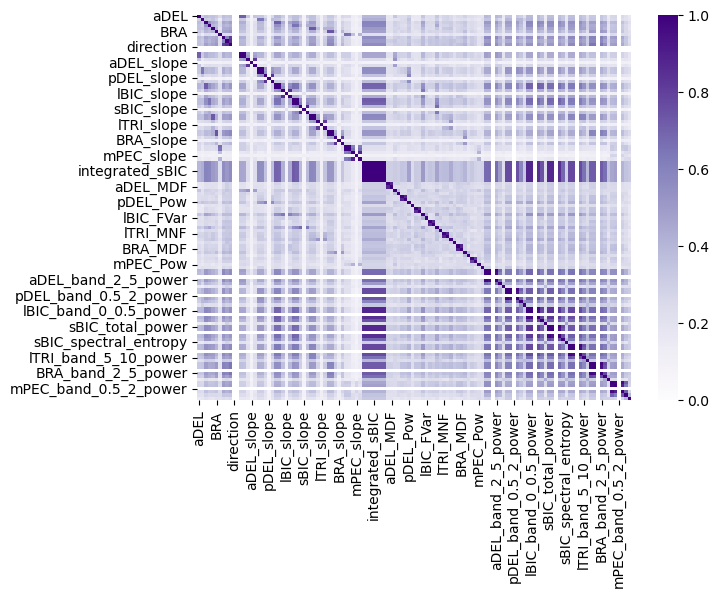

In [70]:
plt.figure(figsize=(7, 5))
corr = sum(df.corr(method="spearman").abs() for df in df_list_timefreq) / len(df_list_timefreq)
sns.heatmap(corr, cmap="Purples", vmin=0, vmax=1);

We can see that the correlation matrix is quite rich although it contains many subgroups of correlated features. The signal matrix was more dense but it's natural that many of these features are not as related to each other as the muscle activations, we want the data to bring different information.

In [71]:
to_drop = df_list_timefreq[0].columns[sum(df.nunique() for df in df_list_timefreq) == len(df_list_timefreq)].tolist()
to_drop.remove("direction"), to_drop.remove("repetition")
to_drop

['aDEL_band_0.5_2_power',
 'pDEL_band_0.5_2_power',
 'lBIC_band_0.5_2_power',
 'sBIC_band_0.5_2_power',
 'lTRI_band_0.5_2_power',
 'BRA_band_0.5_2_power',
 'mPEC_band_0.5_2_power']

One band is removed as it had a single value.

In [72]:
df_list_timefreq = apply_to_dataframe_list(df_list_timefreq, lambda df: df.drop(columns=to_drop, axis=1))

100%|██████████| 48/48 [00:00<00:00, 1997.11it/s]


In [73]:
np.unique([df.shape[1] for df in df_list_timefreq])

array([117])

In [74]:
sum(df.isna().sum().mean() for df in df_list_timefreq)

np.float64(0.0)

In [75]:
merged_df_timefreq = pd.concat(df_list_timefreq).reset_index(drop=True)

In [76]:
merged_df_timefreq = pd.concat(df_list_timefreq)
X = merged_df_timefreq.drop(["force_x", "force_y", "direction", "repetition", "force_magnitude"], axis=1)
force_x = merged_df_timefreq["force_x"]
force_y = merged_df_timefreq["force_y"]
X.columns

Index(['aDEL', 'pDEL', 'lBIC', 'sBIC', 'lTRI', 'BRA', 'mPEC', 'aDEL_mean',
       'aDEL_rms', 'aDEL_var',
       ...
       'BRA_total_power', 'BRA_band_0_0.5_power', 'BRA_band_2_5_power',
       'BRA_band_5_10_power', 'BRA_spectral_entropy', 'mPEC_total_power',
       'mPEC_band_0_0.5_power', 'mPEC_band_2_5_power', 'mPEC_band_5_10_power',
       'mPEC_spectral_entropy'],
      dtype='object', length=112)

In [77]:
with open("merged_df_timefreq.pkl", "wb") as file:
    pickle.dump(merged_df_timefreq, file)

We check a low-dimensional representation of the new dataset.

In [78]:
scaler = StandardScaler().fit(X)
X_scaled = pd.DataFrame(scaler.transform(X), columns=scaler.get_feature_names_out())

In [79]:
# tsne_comps_timefreq = TSNE(n_components=2, perplexity=160).fit_transform(X_scaled)
pca = PCA(n_components=2).fit(X_scaled) 
pca_comps_timefreq = pca.transform(X_scaled)

In [80]:
# fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
# sns.scatterplot(x=tsne_comps_timefreq[:, 0], y=tsne_comps_timefreq[:, 1], hue=force_x, alpha=0.5, palette="plasma", ax=ax1)
# sns.scatterplot(x=tsne_comps_timefreq[:, 0], y=tsne_comps_timefreq[:, 1], hue=force_y, alpha=0.5, palette="plasma", ax=ax2);

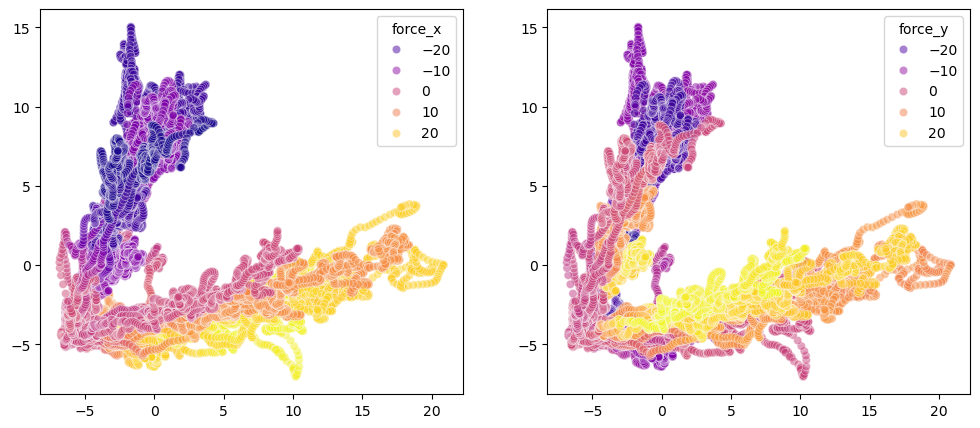

In [81]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
sns.scatterplot(x=pca_comps_timefreq[:, 0], y=pca_comps_timefreq[:, 1], hue=force_x, alpha=0.5, palette="plasma", ax=ax1)
sns.scatterplot(x=pca_comps_timefreq[:, 0], y=pca_comps_timefreq[:, 1], hue=force_y, alpha=0.5, palette="plasma", ax=ax2);

In [82]:
for i, comp in enumerate(pca.components_, start=1):
    print(f"PC{i} top features:")
    idxs = comp.argsort()[::-1][:5]
    for ind in idxs:
        print(f"{X.columns[ind]}: {comp[ind]}")
    print()

PC1 top features:
lTRI_total_power: 0.16861049317467636
lTRI_band_0_0.5_power: 0.16859863588943153
lTRI_band_2_5_power: 0.16839669590541015
lBIC_mean: 0.16701217232186588
lBIC_rms: 0.166995604688173

PC2 top features:
mPEC_total_power: 0.18066901931350932
mPEC_band_0_0.5_power: 0.18061601400884328
mPEC_mean: 0.18055530492409552
mPEC_band_2_5_power: 0.17963899520717855
mPEC_rms: 0.17948696914743592



PC1 seems to focu on triceps and biceps features, while the other one on pectoral features.

### Regression Task

Now we start modelling with the datasets.

We were tasked to try polynomial regression with different degrees, still we'll do other experiments with more complex models.

The test split was done by isolating the last repetiton, since it made sense to use the history of the repetitions to predict the final one.

Similarly for model validation, we implemented a GroupKFold cross-validation scheme that focused on preserving consistency across repetitions. Specifically, we held out one repetition as the validation set and used the remaining two repetitions for training. This yielded three folds, where in each fold, the model was trained on two of the three repetitions and validated on the third.

While three folds are generally considered a small number for cross-validation and may limit the statistical robustness of the performance estimates, this approach was necessary to maintain the repetition-level consistency we defined and prevent data leakage. We believe that generalizing well for different repetition is critical for evaluating how well the model generalizes across different instances of the same task.

With access to a larger dataset, with more patients and a greater number of repetitions we could adopt a more robust scheme, such as performing GroupKFold CV based on patient identifiers. This would allow us to train the model on data from a subset of subjects and test its generalization to unseen individuals, producing models that are more reliable and broadly applicable in real-world scenarios.

#### Raw signals

First we'll use the dataset using only the signals. There are only 7 columns so polynomial features are liekly to be a good idea.

In [83]:
from sklearn.model_selection import train_test_split, GroupKFold
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import root_mean_squared_error, r2_score

In [84]:
df_trval, df_te = merged_df[merged_df["repetition"] != 3], merged_df[merged_df["repetition"] == 3]
y_trval, y_te = merged_df[merged_df["repetition"] != 3][["force_x", "force_y"]], merged_df[merged_df["repetition"] == 3][["force_x", "force_y"]]

X_trval, X_te = df_trval.iloc[:, :-5], df_te.iloc[:, :-5]
print(X_trval.columns.tolist())
X_trval.shape, X_te.shape, y_trval.shape, y_te.shape

['aDEL', 'pDEL', 'lBIC', 'sBIC', 'lTRI', 'BRA', 'mPEC']


((15642, 7), (4845, 7), (15642, 2), (4845, 2))

In [85]:
print(set(df_trval["repetition"]), "\n\n", set(df_te["repetition"]))

{0, 1, 2} 

 {3}


We confirm that the two sets don't share repetitions.

In [86]:
folds_raw = [(tr_idxs, val_idxs) for tr_idxs, val_idxs in GroupKFold(n_splits=3).split(X_trval, y_trval, groups=df_trval["repetition"])]

We will perform GrouKFold CV (with a total of three folds) to evaluate the models. The function allows to compute poly features + interactions of d degree and scale the data.

Since sklearn models fit a separate model for each different output when we pass more that one, we don't need to manually handle the double outputs.

In [87]:
def cross_validate_poly(X, y, model, folds, scaler = None, poly_degrees = range(1, 6), ):
    print(f"{model.__class__.__name__}:")
    best_d, best_r2, best_score =   1, -1,float("inf")
    for d in poly_degrees:
        d_rmse = 0
        d_r2 = 0
        for i, (tr_idxs, val_idxs) in enumerate(folds):
            X_tr, X_val = X.iloc[tr_idxs], X.iloc[val_idxs]
            y_tr, y_val = y.iloc[tr_idxs], y.iloc[val_idxs]
            
            poly = PolynomialFeatures(degree=d, include_bias=False)
            X_tr_poly = poly.fit_transform(X_tr)
            X_val_poly = poly.transform(X_val)
            
            if scaler:
                scaler.fit(X_tr_poly)
                X_tr_poly = pd.DataFrame(scaler.transform(X_tr_poly), columns=scaler.get_feature_names_out())
                X_val_poly = pd.DataFrame(scaler.transform(X_val_poly), columns=scaler.get_feature_names_out())

            est = model.fit(X_tr_poly, y_tr) 
            tr_preds = est.predict(X_tr_poly)
            y_preds = est.predict(X_val_poly)
            fold_rmse = root_mean_squared_error(y_val, y_preds)
            fold_r2 = r2_score(y_val, y_preds)
            
            print(f"Degree {d} - fold {i+1}   |   Train RMSE: {root_mean_squared_error(y_tr, tr_preds)}   |   Train R^2: {r2_score(tr_preds, y_tr)}   |   Valid RMSE: {fold_rmse}   |   Valid R^2: {fold_r2}")
            d_rmse+=fold_rmse
            d_r2+=fold_r2
            
        d_rmse /= len(folds)
        d_r2 /= len(folds)
        print(f"\nd={d} Mean Valid RMSE: {d_rmse}   |   Mean Valid R^2: {d_r2}")
        print("\n\n")
        
        if d_rmse < best_score:
            best_score = d_rmse
            best_r2 = d_r2
            best_d = d
            
    print(f"Best found RMSE: {best_score} and R^2: {best_r2} with d={best_d}")
    return best_d, best_score, est

In [88]:
from sklearn.preprocessing import StandardScaler, RobustScaler

In [89]:
d_1, _, lr_1 = cross_validate_poly(X_trval, y_trval, LinearRegression(), folds_raw, RobustScaler(), poly_degrees=range(1, 5))

LinearRegression:
Degree 1 - fold 1   |   Train RMSE: 6.437742602701025   |   Train R^2: 0.7886214208903524   |   Valid RMSE: 6.212782980048052   |   Valid R^2: 0.8363680311007966
Degree 1 - fold 2   |   Train RMSE: 6.07626757270182   |   Train R^2: 0.8146192309705095   |   Valid RMSE: 7.414543270103211   |   Valid R^2: 0.7688212230540092
Degree 1 - fold 3   |   Train RMSE: 6.252892698915485   |   Train R^2: 0.8005192961783447   |   Valid RMSE: 6.643411690743276   |   Valid R^2: 0.8175123601966263

d=1 Mean Valid RMSE: 6.756912646964847   |   Mean Valid R^2: 0.8075672047838106



Degree 2 - fold 1   |   Train RMSE: 4.719590487866811   |   Train R^2: 0.9004604779286092   |   Valid RMSE: 4.786811424814603   |   Valid R^2: 0.9042879601636766
Degree 2 - fold 2   |   Train RMSE: 4.476322259680414   |   Train R^2: 0.909890327756394   |   Valid RMSE: 5.657505811312671   |   Valid R^2: 0.8695552819654946
Degree 2 - fold 3   |   Train RMSE: 4.634896367608118   |   Train R^2: 0.902946439100493  

A simple linear regression using polynomial features is able to obtain great R^2 and RMSE. With only the signals it's already able to obtain an r squared of 0.8, which increases with 2 and 3 (3 has lower RMSE), then progressively worsen as the degree increase.

In [90]:
_,_, ridge_1 = cross_validate_poly(X_trval, y_trval, Ridge(), folds_raw, RobustScaler(), poly_degrees=range(1, 6));

Ridge:
Degree 1 - fold 1   |   Train RMSE: 6.437743652974387   |   Train R^2: 0.7885393369743402   |   Valid RMSE: 6.212322690684799   |   Valid R^2: 0.8363954234685257
Degree 1 - fold 2   |   Train RMSE: 6.07626849337168   |   Train R^2: 0.8145564443851055   |   Valid RMSE: 7.414609467107033   |   Valid R^2: 0.7688094307091555
Degree 1 - fold 3   |   Train RMSE: 6.252893603346326   |   Train R^2: 0.8004513188114073   |   Valid RMSE: 6.6438658460910425   |   Valid R^2: 0.8174865523581001

d=1 Mean Valid RMSE: 6.756932667960958   |   Mean Valid R^2: 0.8075638021785938



Degree 2 - fold 1   |   Train RMSE: 4.719719656318365   |   Train R^2: 0.9003225248860678   |   Valid RMSE: 4.784781329466066   |   Valid R^2: 0.9043729268080961
Degree 2 - fold 2   |   Train RMSE: 4.476448594955421   |   Train R^2: 0.9097765121610467   |   Valid RMSE: 5.6586726181678735   |   Valid R^2: 0.8694969040514233
Degree 2 - fold 3   |   Train RMSE: 4.63503098693794   |   Train R^2: 0.9028161973435322   |   Val

l2 regularized regression has a very similar pattern to the previous model, with slightly better scores. 

In [91]:
cross_validate_poly(X_trval, y_trval, Lasso(), folds_raw, RobustScaler(), range(1, 5));

Lasso:
Degree 1 - fold 1   |   Train RMSE: 7.174038537199801   |   Train R^2: 0.5940433369443117   |   Valid RMSE: 6.721029807217657   |   Valid R^2: 0.8079391105163545
Degree 1 - fold 2   |   Train RMSE: 6.855180143570483   |   Train R^2: 0.650908560775669   |   Valid RMSE: 7.639443058113917   |   Valid R^2: 0.7482597710234167
Degree 1 - fold 3   |   Train RMSE: 6.967747730615997   |   Train R^2: 0.6308006985032919   |   Valid RMSE: 7.719347399076211   |   Valid R^2: 0.7513040105669083

d=1 Mean Valid RMSE: 7.359940088135929   |   Mean Valid R^2: 0.7691676307022265



Degree 2 - fold 1   |   Train RMSE: 7.092157387452499   |   Train R^2: 0.6462259363347007   |   Valid RMSE: 7.154036331860283   |   Valid R^2: 0.781626982087725
Degree 2 - fold 2   |   Train RMSE: 6.858785539747723   |   Train R^2: 0.6721169033181397   |   Valid RMSE: 7.655188303704739   |   Valid R^2: 0.753296460501369
Degree 2 - fold 3   |   Train RMSE: 6.96354165624547   |   Train R^2: 0.6582174197995407   |   Valid R

Out of the three linear algorithms LR and Ridge seems to be quite similar, with LASSO being the worst one. Ridge seems to have a slight§ edge in this case.

In [92]:
poly =  PolynomialFeatures(degree=3, include_bias=False).fit(X_trval)
X_trval_poly = pd.DataFrame(poly.transform(X_trval), columns=poly.get_feature_names_out())
X_te_poly = pd.DataFrame(poly.transform(X_te), columns=poly.get_feature_names_out())

robust = RobustScaler().fit(X_trval_poly)
X_trval_poly_scaled = pd.DataFrame(robust.transform(X_trval_poly), columns=robust.get_feature_names_out())
X_te_poly_scaled = pd.DataFrame(robust.transform(X_te_poly), columns=robust.get_feature_names_out())

lr = Ridge().fit(X_trval_poly_scaled, y_trval)
pred_te = lr.predict(X_te_poly_scaled)

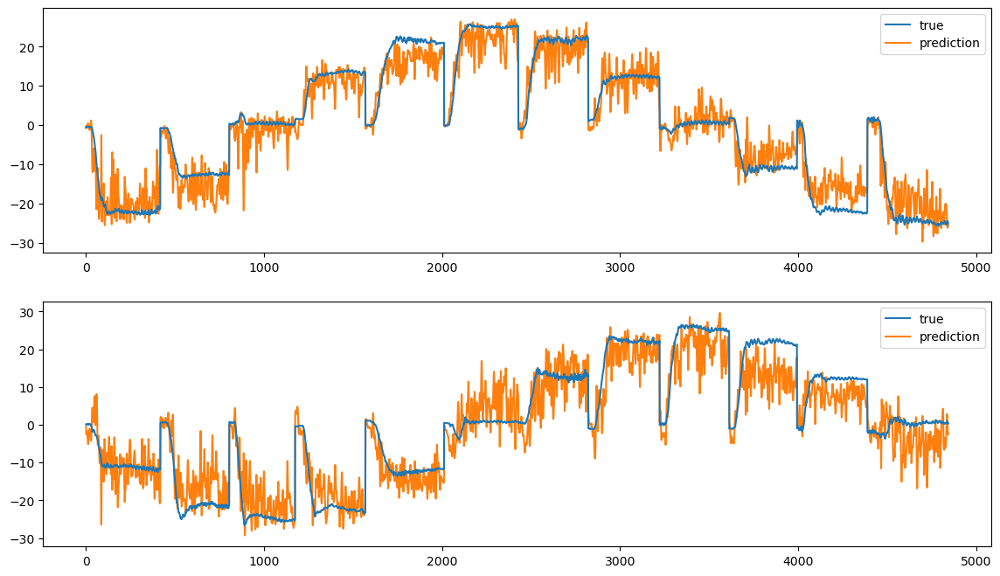

In [93]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 8))

x_axis = np.arange(len(y_te))

ax1.plot(x_axis, y_te.values[:, 0], label="true")
ax1.plot(x_axis, pred_te[:,0], label="prediction", zorder=1)
ax1.legend()


ax2.plot(x_axis, y_te.values[:, 1], label="true")
ax2.plot(x_axis, pred_te[:,1], label="prediction", zorder=1)
ax2.legend();

The Ridge model with 3rd degree polynomial features does a good job of capturing the twelve levels induced by our directions, but it can be seen that it tends to over-react to the high-frequency noise, especially around the sharp transitions between levels. The result is a good amount of noise, likely the regularization isn’t strong enough to fully suppress the noisy fluctuations. Yet LASSO performed badly.

We define a function to extract the naive linear feature importance. These models have intrinsic interpretability due to their coefficients that directly multiply the covariates, however the feature we used were polynomial features which make the esplanation harder. We extract the top coefficients, and extract the original muscles with an aggregation.

In [94]:
def plot_and_aggregate_feature_importance(feature_coef_tuples, base_features, output_names=None):
    feature_names = [f[0] for f in feature_coef_tuples]
    coefs = np.array([f[1:] for f in feature_coef_tuples])
    
    n_outputs = coefs.shape[1]
    if output_names is None:
        output_names = [f"Output {i+1}" for i in range(n_outputs)]

    for i in range(n_outputs):
        sorted_idx = np.argsort(np.abs(coefs[:, i]))[::-1]
        top_features = [feature_names[j] for j in sorted_idx[:20]]
        top_coefs = coefs[sorted_idx[:20], i]

        plt.figure(figsize=(10, 6))
        bars = plt.barh(range(len(top_features)), top_coefs, color='skyblue')
        plt.yticks(range(len(top_features)), top_features)
        plt.xlabel('Coefficient')
        plt.title(f'Top 20 Feature Importances for {output_names[i]}')
        plt.gca().invert_yaxis()
        plt.grid(True, axis='x')
        plt.show()

    agg_dict = {bf: np.zeros(n_outputs) for bf in base_features}

    for feat_name, coef_vals in zip(feature_names, coefs):
        for bf in base_features:
            if bf in feat_name:
                agg_dict[bf] += np.abs(coef_vals)

    agg_importance_df = pd.DataFrame(agg_dict, index=output_names).T

    return agg_importance_df

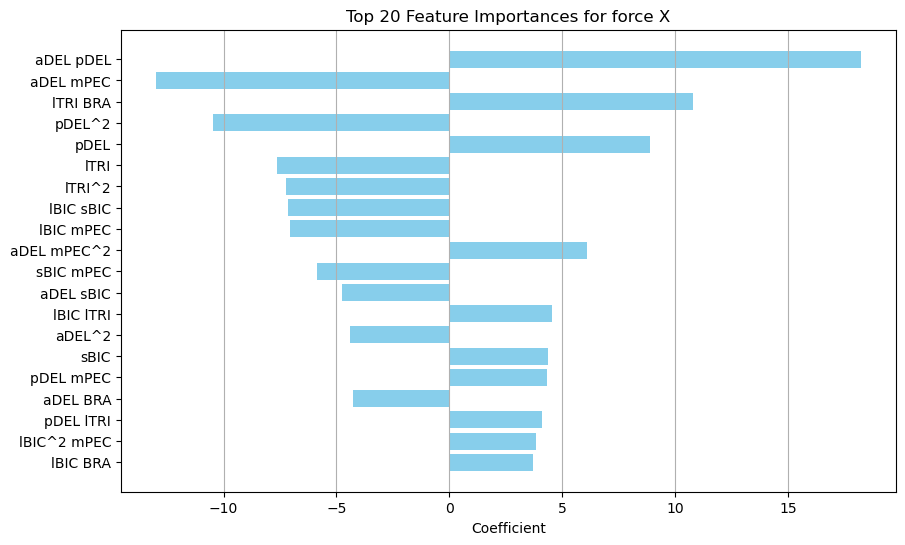

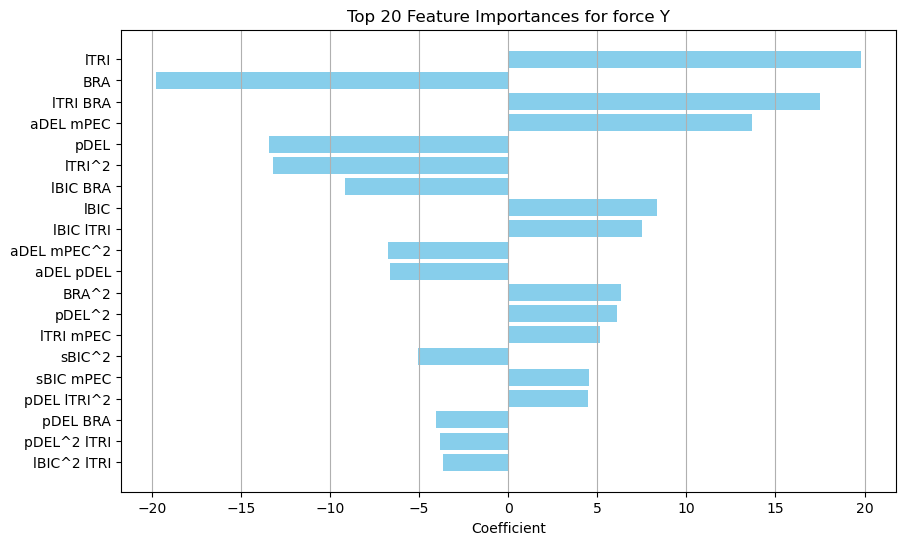

In [95]:
importance_df_raw = plot_and_aggregate_feature_importance(list(zip(X_trval_poly_scaled.columns.tolist(), *lr.coef_)), 
                                                          base_features=X_trval.columns.tolist(), 
                                                          output_names=["force X", "force Y"])


In [96]:
importance_df_raw["force X"].sort_values(ascending=False)

aDEL    88.258327
pDEL    79.055207
lTRI    71.680958
mPEC    68.703183
lBIC    65.899327
sBIC    52.161944
BRA     50.336646
Name: force X, dtype: float64

In [97]:
importance_df_raw["force Y"].sort_values(ascending=False)

lTRI    116.904107
BRA      92.214351
pDEL     71.235711
aDEL     70.567114
mPEC     66.132431
lBIC     63.429248
sBIC     47.641339
Name: force Y, dtype: float64

In [98]:
y_preds = lr.predict(X_te_poly_scaled)

print(f"Test R^2: {r2_score(y_te, y_preds)}, Test RMSE: {root_mean_squared_error(y_te, y_preds)}")

Test R^2: 0.9010228979978405, Test RMSE: 4.9351011644671186


In [99]:
importance_df_raw.mean(axis=1).sort_values(ascending=False)

lTRI    94.292532
aDEL    79.412720
pDEL    75.145459
BRA     71.275499
mPEC    67.417807
lBIC    64.664287
sBIC    49.901641
dtype: float64

* lTRI (Triceps long head) are the most useful feature for the model, they are the primary elbow extensor, useful for pushing force.

* Deltoids (aDEL, pDEL):
        * aDEL: Shoulder flexor, important for forward/reaching movements.
        * pDEL: Shoulder extensor, important for pulling or stabilizing.

The experiment combined isometric force steps (where lTRI and Deltoids are key) and planar reaching (requiring shoulder-elbow coordination).

Next we check the residuals to have a complete view of the performance of the linear models.

In [100]:
ridge_resid = y_te.values - pred_te

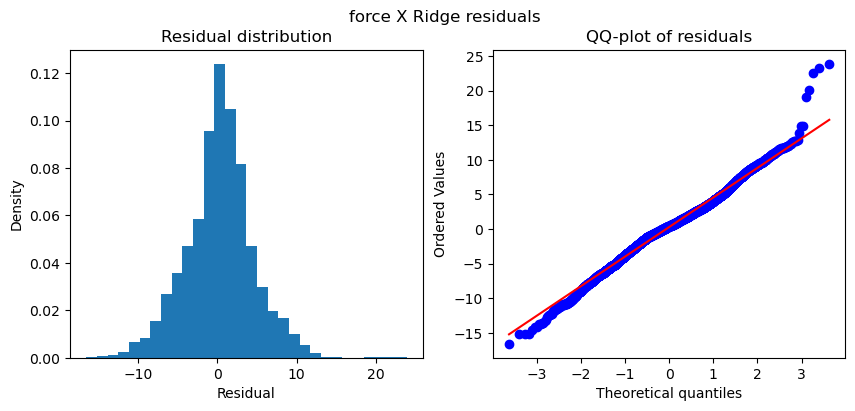

In [101]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10, 4))
fig.suptitle("force X Ridge residuals")
ax1.hist(ridge_resid[:,0], bins=30, density=True)
ax1.set_xlabel('Residual')
ax1.set_ylabel('Density')
ax1.set_title('Residual distribution')

stats.probplot(ridge_resid[:, 0], dist="norm", plot=ax2)
plt.title('QQ-plot of residuals')
plt.show()


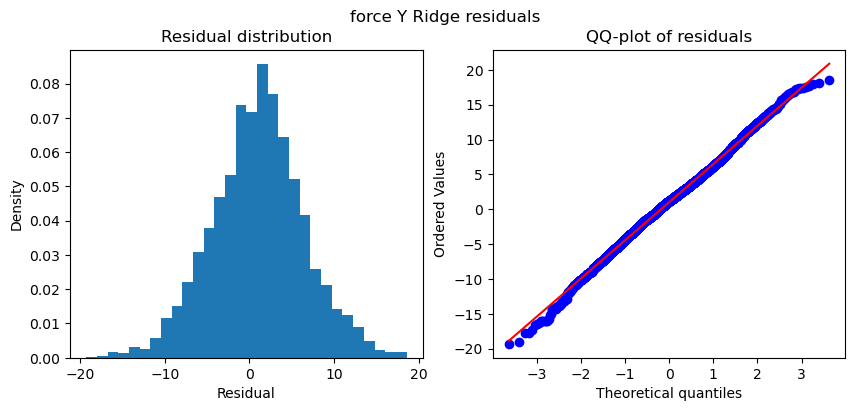

In [102]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10, 4))
fig.suptitle("force Y Ridge residuals")
ax1.hist(ridge_resid[:,1], bins=30, density=True)
ax1.set_ylabel('Density')
ax1.set_xlabel('Residual')
ax1.set_title('Residual distribution')

stats.probplot(ridge_resid[:, 1], dist="norm", plot=ax2)
plt.title('QQ-plot of residuals')
plt.show()


Thre residuals of both force X and Y are almost perfectly normal, the points in the QQ plots follow the line perfectly, with a deviation near the upper end, slighltly right skewed.

Next we check for homoskedasticity.

If the the residuals have constant variance across all levels of the independent variables , is assumed in linear regression because it ensures the validity of statistical inference. 
Sklearn LR is more centered on performance than statistical correctness but it's still an interesting an alysis.

We use the Breusch Pagan test.

| Test    | H0 | H1 |
| --------| ------- | ------- |
| Breusch-Pagan     | The residuals are homoskedastic  |  heteroskedastic     |


In [103]:
from statsmodels.stats.diagnostic import het_breuschpagan
import statsmodels.api as sm

In [104]:
def heteroskedasticity_test(residuals, x_te, alpha=0.05):
    bp_test_p_val = het_breuschpagan(residuals, sm.add_constant(x_te))[1]
    if bp_test_p_val < alpha:
        print(f"Reject H0: The residuals are likely heteroskedastic")
    else:
        print(f"Don't reject H0: The residuals are likely homoskedastic")
    return bp_test_p_val

In [105]:
heteroskedasticity_test(ridge_resid[:,1], X_te_poly_scaled);

Reject H0: The residuals are likely heteroskedastic


In [106]:
heteroskedasticity_test(ridge_resid[:,0], X_te_poly_scaled);

Reject H0: The residuals are likely heteroskedastic


The residuals are likely heteroskedastic.
This would be a red flag if we were doing a statistical pipeline, however here the RMSE, R2 and normality of the residuals was great.
Still it may mean that there is some more complex non-linear structure in the data, that can't easily be modelled by poly regression. Later we'll try more advanced models. 

Next we will perform a type of residual bootstrapping to obtain prediction intevals.
Using our folds, we'll extract the validation residuals and extract quantiles from them. Since we are not using the training errors like in typical bootstrapping the intervals should be wider.

In [107]:
from sklearn.base import clone

def cv_residual_bootstrap(model, X, y, folds, X_test, n_boot=1000, alpha=0.05):
    res = []
    if type(X) == pd.DataFrame:
        X = X.values 
    if type(X_test) == pd.DataFrame:
        X_test = X_test.values   

    for tr, va in tqdm(folds):
        m = clone(model)
        m.fit(X[tr], y[tr])
        res.append(y[va] - m.predict(X[va]))
        

    res = np.concatenate(res)
    m_full = clone(model).fit(X, y)
    y_pred = m_full.predict(X_test)
    boot = np.zeros((n_boot, len(X_test)))
    for i in range(n_boot):
        boot[i] = y_pred + np.random.choice(res, size=len(X_test), replace=True)
    return (
        np.quantile(boot, alpha/2, axis=0),
        np.quantile(boot, 1 - alpha/2, axis=0),
    )

100%|██████████| 3/3 [00:00<00:00, 55.26it/s]


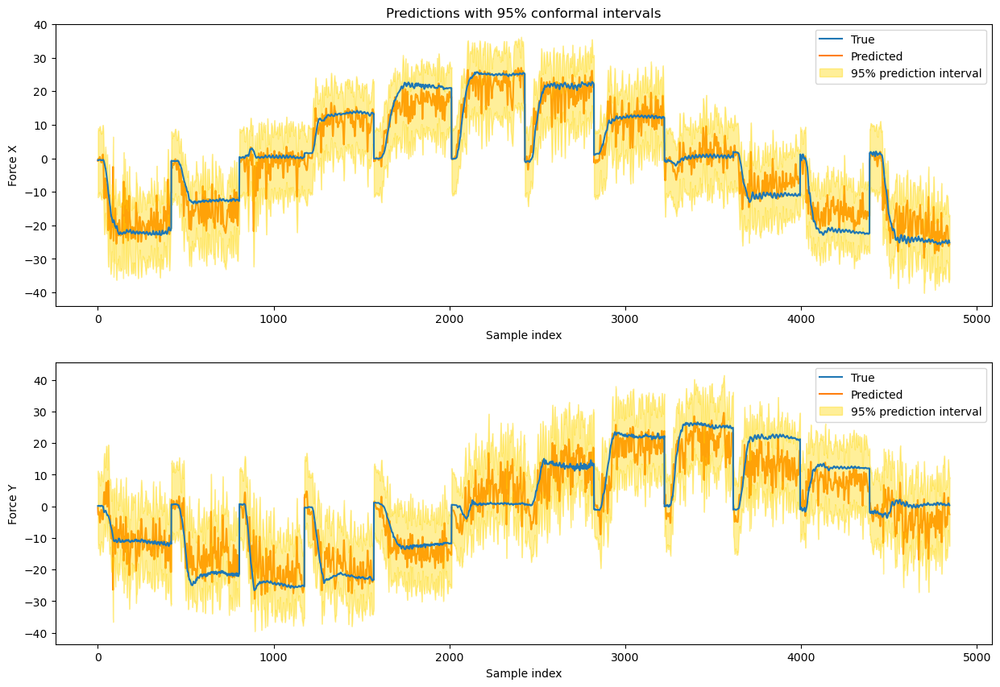

In [108]:
lower_x, upper_x = cv_residual_bootstrap(
    Ridge(), X_trval_poly_scaled, y_trval.values[:,0], folds_raw, X_te_poly_scaled,
    n_boot=5000, alpha=0.05
)
lower_y, upper_y = cv_residual_bootstrap(
    Ridge(), X_trval_poly_scaled, y_trval.values[:,1], folds_raw, X_te_poly_scaled,
    n_boot=5000, alpha=0.05
)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 10))

x_axis = np.arange(len(y_te))

ax1.plot(y_te.values[:,0], label='True')
ax1.plot(pred_te[:, 0], label='Predicted', zorder=1)
ax1.fill_between(np.arange(len(pred_te)), lower_x, upper_x, alpha=0.4, label='95% prediction interval', color='gold')
ax1.set_xlabel('Sample index')
ax1.set_ylabel('Force X')
ax1.set_title('Predictions with 95% conformal intervals')
ax1.legend()

ax2.plot(y_te.values[:,1], label='True')
ax2.plot(pred_te[:, 1], label='Predicted', zorder=1)
ax2.fill_between(np.arange(len(pred_te)), lower_y, upper_y, alpha=0.4, label='95% prediction interval', color='gold')
ax2.set_xlabel('Sample index')
ax2.set_ylabel('Force Y')
ax2.legend();

Of course the intervals are as noisy as the prediction itself, but we can see that every part of the ground truth is included in our quantile interval, and we could even increase the alpha.

In [ ]:
from utils.helpers import create_biomechanics_animation

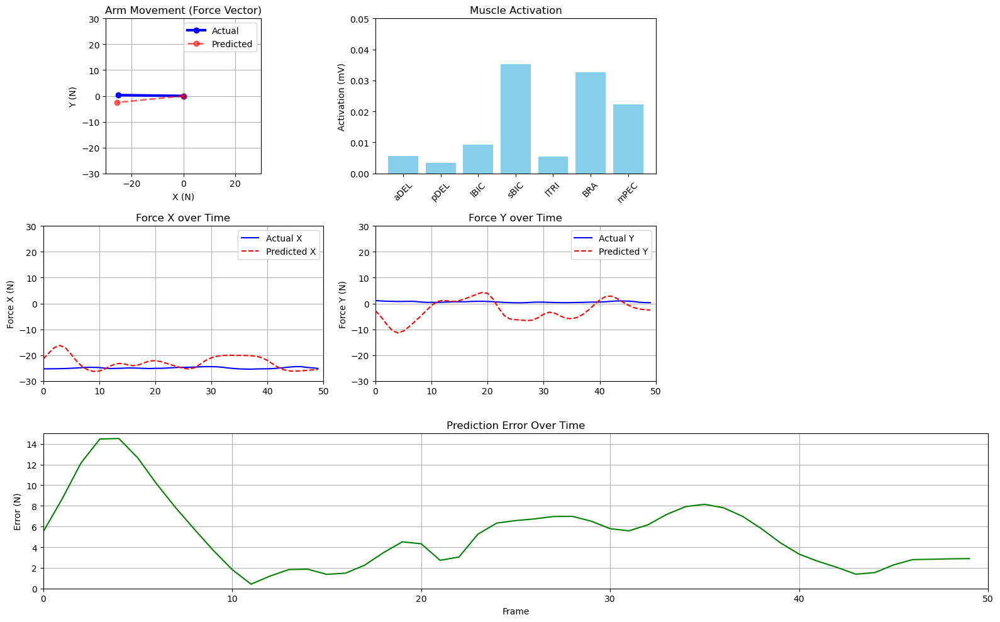

In [ ]:
model_dict={"ridge": {"predictions":pred_te, "RMSE" : 2}}
create_biomechanics_animation(model_dict,merged_df, 3, muscle_fields);

From the animation we can confirm that the predictions are a lot noisier than the true series. The predicted pointer starts moving even before the actual movements begins.

#### Time-Frequency features + PCA

Next we try using the features we extracted. The data is significantly higher-dimensional now, to help the models generalize and reduce running time, we will use dimensionality reduction and feature selection methods.

We define a function to find the number of PCA components to get X% of variance, we'll be using this to tune the PCA reduction.

In [109]:
def pca_variance_threshold(X, t=0.9, plot=True):
    pca = PCA().fit(StandardScaler().fit_transform(X))
    
    cumulative_variance = pca.explained_variance_ratio_.cumsum()
    if plot:
        plt.figure(figsize=(10, 6))
        plt.plot(cumulative_variance, marker='o')
        plt.axhline(t, c="r")
        plt.xlabel('Number of Components')
        plt.ylabel('Cumulative Explained Variance')
        plt.show()
    
    count=1
    for var in cumulative_variance:
        if var<t:
            count+=1
            continue
        return count

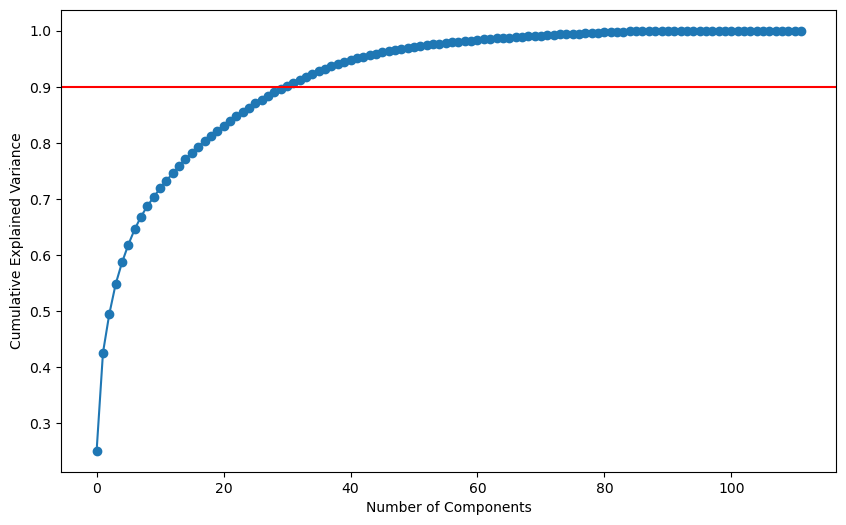

Components: 31


In [110]:
print(f"Components: {pca_variance_threshold(X_scaled, t=0.9)}")

In [111]:
df_trval_tf, df_te_tf = merged_df_timefreq[merged_df_timefreq["repetition"] != 3], merged_df_timefreq[merged_df_timefreq["repetition"] == 3]
y_trval_tf, y_te_tf = merged_df_timefreq[merged_df_timefreq["repetition"] != 3][["force_x", "force_y"]], merged_df_timefreq[merged_df_timefreq["repetition"] == 3][["force_x", "force_y"]]

X_trval_tf, X_te_tf = df_trval_tf.drop(["force_x", "force_y", "repetition", "direction", "force_magnitude"],axis=1), df_te_tf.drop(["force_x", "force_y", "repetition", "direction", "force_magnitude"],axis=1)
X_trval_tf.shape, X_te_tf.shape, y_trval_tf.shape, y_te_tf.shape

((15642, 112), (4845, 112), (15642, 2), (4845, 2))

In [112]:
print(set(df_trval_tf["repetition"]), "\n\n", set(df_te_tf["repetition"]))

{0, 1, 2} 

 {3}


In [113]:
X_trval_tf.columns.str.contains('direction|repetition|force', regex=True).any() or X_te_tf.columns.str.contains('direction|repetition|force', regex=True).any()

np.False_

In [114]:
folds_tf = [(tr_idxs, val_idxs) for tr_idxs, val_idxs in GroupKFold(n_splits=3).split(X_trval_tf, y_trval_tf, groups=df_trval_tf["repetition"])]

The next function is like the previous CV, but allows also do to one PCA before the definition of the polynomial variables, to not obtain an absurd number of them. Then, one can also decide to apply another PCA after their addition.

In [115]:
def cross_validate_poly_pca(X, y, model, folds, poly_degrees = range(1, 6), double_pca = False, pca_var_thresholds=[0.9]):
    print(f"{model.__class__.__name__}:")
    best_d, best_r2, best_score =   1, -1,float("inf")

    for d in poly_degrees:
        d_rmse = 0
        d_r2 = 0
        for i, (tr_idxs, val_idxs) in enumerate(folds):
            X_tr, X_val = X.iloc[tr_idxs], X.iloc[val_idxs]
            y_tr, y_val = y.iloc[tr_idxs], y.iloc[val_idxs]
                
            n_comps1 = pca_variance_threshold(X_tr, plot=False, t=pca_var_thresholds[0])        
            scaler = StandardScaler().fit(X_tr)
            X_tr = pd.DataFrame(scaler.transform(X_tr), columns=scaler.get_feature_names_out())
            X_val = pd.DataFrame(scaler.transform(X_val), columns=scaler.get_feature_names_out())
            
            pca1 = PCA(n_components=n_comps1)
            X_tr_red = pca1.fit_transform(X_tr)
            X_val_red = pca1.transform(X_val)      
            
            poly = PolynomialFeatures(degree=d, include_bias=False)
            X_tr_poly = poly.fit_transform(X_tr_red)
            X_val_poly = poly.transform(X_val_red)
            
            if double_pca:
                n_comps2 = pca_variance_threshold(X_tr_poly, plot=False, t=pca_var_thresholds[1]) 
                pca2 = PCA(n_components=n_comps2)
                scaler = StandardScaler().fit(X_tr_poly)
                X_tr_poly = pd.DataFrame(scaler.transform(X_tr_poly), columns=scaler.get_feature_names_out())
                X_val_poly = pd.DataFrame(scaler.transform(X_val_poly), columns=scaler.get_feature_names_out())
                X_tr_poly = pca2.fit_transform(X_tr_poly)
                X_val_poly = pca2.transform(X_val_poly)  
            
            est = model.fit(X_tr_poly, y_tr) 
            tr_preds = est.predict(X_tr_poly)
            y_preds = est.predict(X_val_poly)
            fold_rmse = root_mean_squared_error(y_val, y_preds)
            fold_r2 = r2_score(y_val, y_preds)
            
            print(f"Degree {d} - fold {i+1}   |   Train RMSE: {root_mean_squared_error(y_tr, tr_preds)}   |   Train R^2: {r2_score(tr_preds, y_tr)}   |   Valid RMSE: {fold_rmse}   |   Valid R^2: {fold_r2}")
            d_rmse+=fold_rmse
            d_r2+=fold_r2
            
        d_rmse /= len(folds)
        d_r2 /= len(folds)
        print(f"\nd={d} Mean Valid RMSE: {d_rmse}   |   Mean Valid R^2: {d_r2}")
        print("\n\n")
        
        if d_rmse < best_score:
            best_score = d_rmse
            best_d = d
            best_r2 = d_r2
    print(f"Best found RMSE: {best_score} and R^2: {best_r2} with d={best_d}")
    return best_d, best_score

Due to the quantity of features after the polynomial ones are added, we first apply a lower variance PCA (t=0.7) to get around 10 features, then we get the polynomial features and finally apply a less strict PCA (t=0.9).

In [116]:
d2, _ = cross_validate_poly_pca(X_trval_tf, y_trval_tf, LinearRegression(), folds_tf, range(1, 5), double_pca=True, pca_var_thresholds=[0.7, 0.9])

LinearRegression:
Degree 1 - fold 1   |   Train RMSE: 5.949584934893403   |   Train R^2: 0.7936067692131821   |   Valid RMSE: 6.028569197438945   |   Valid R^2: 0.8333218553743876
Degree 1 - fold 2   |   Train RMSE: 5.627693276971347   |   Train R^2: 0.8228046262288974   |   Valid RMSE: 7.56340488497838   |   Valid R^2: 0.7291496447138621
Degree 1 - fold 3   |   Train RMSE: 6.145910154139365   |   Train R^2: 0.7963453926323131   |   Valid RMSE: 7.230764714389534   |   Valid R^2: 0.7814385925957548

d=1 Mean Valid RMSE: 6.940912932268954   |   Mean Valid R^2: 0.7813033642280015



Degree 2 - fold 1   |   Train RMSE: 6.061517984144373   |   Train R^2: 0.81675419476037   |   Valid RMSE: 6.997702586121486   |   Valid R^2: 0.7962916435061571
Degree 2 - fold 2   |   Train RMSE: 6.170448292386901   |   Train R^2: 0.8106718443761354   |   Valid RMSE: 9.881625407429766   |   Valid R^2: 0.6005674514622039
Degree 2 - fold 3   |   Train RMSE: 5.932384926839662   |   Train R^2: 0.8280285136703757  

In [287]:
d2, _ = cross_validate_poly_pca(X_trval_tf, y_trval_tf, Ridge(), folds_tf, range(1, 5), double_pca=True, pca_var_thresholds=[0.7, 0.9])

Ridge:
Degree 1 - fold 1   |   Train RMSE: 5.94958514245828   |   Train R^2: 0.7935652792932884   |   Valid RMSE: 6.0285448746359505   |   Valid R^2: 0.8333272319409306
Degree 1 - fold 2   |   Train RMSE: 5.627693468020712   |   Train R^2: 0.8227711130851376   |   Valid RMSE: 7.562763575339049   |   Valid R^2: 0.7291927205100506
Degree 1 - fold 3   |   Train RMSE: 6.145910308691565   |   Train R^2: 0.7963075070882408   |   Valid RMSE: 7.230768475586148   |   Valid R^2: 0.7814367316206662

d=1 Mean Valid RMSE: 6.940692308520383   |   Mean Valid R^2: 0.781318894690549



Degree 2 - fold 1   |   Train RMSE: 6.061518042722046   |   Train R^2: 0.8167353927602583   |   Valid RMSE: 6.9977163407983145   |   Valid R^2: 0.7962908981735055
Degree 2 - fold 2   |   Train RMSE: 6.170448341294643   |   Train R^2: 0.8106541988492886   |   Valid RMSE: 9.881345803766793   |   Valid R^2: 0.6005888205484107
Degree 2 - fold 3   |   Train RMSE: 5.932384981614296   |   Train R^2: 0.8280116587556317   |   Val

In [117]:
d2, _ = cross_validate_poly_pca(X_trval_tf, y_trval_tf, LinearRegression(), folds_tf, poly_degrees=range(1, 3), double_pca=False, pca_var_thresholds=[0.9, 0.9])

LinearRegression:
Degree 1 - fold 1   |   Train RMSE: 4.878617480758705   |   Train R^2: 0.875803736341201   |   Valid RMSE: 5.472140476477792   |   Valid R^2: 0.8627038960567266
Degree 1 - fold 2   |   Train RMSE: 4.896874013152011   |   Train R^2: 0.8716298860279984   |   Valid RMSE: 7.673637437865533   |   Valid R^2: 0.7344420321915723
Degree 1 - fold 3   |   Train RMSE: 4.6366187106804215   |   Train R^2: 0.8851211069667217   |   Valid RMSE: 5.976269912302666   |   Valid R^2: 0.840124277846561

d=1 Mean Valid RMSE: 6.37401594221533   |   Mean Valid R^2: 0.81242340203162



Degree 2 - fold 1   |   Train RMSE: 1.73137704021971   |   Train R^2: 0.98744124391672   |   Valid RMSE: 4.855197287795928   |   Valid R^2: 0.8999582406840503
Degree 2 - fold 2   |   Train RMSE: 1.6303141689326759   |   Train R^2: 0.9884141925137256   |   Valid RMSE: 6.381862375460114   |   Valid R^2: 0.8323155502951824
Degree 2 - fold 3   |   Train RMSE: 1.6325683501596275   |   Train R^2: 0.9886196557390989   |

In [279]:
d2, _ = cross_validate_poly_pca(X_trval_tf, y_trval_tf, Ridge(), folds_tf, poly_degrees=range(1, 3), double_pca=False, pca_var_thresholds=[0.9, 0.9])

Ridge:
Degree 1 - fold 1   |   Train RMSE: 4.878617493744169   |   Train R^2: 0.8757989962687975   |   Valid RMSE: 5.472103442746643   |   Valid R^2: 0.8627061161290814
Degree 1 - fold 2   |   Train RMSE: 4.896874022171757   |   Train R^2: 0.8716258500980671   |   Valid RMSE: 7.673505973606382   |   Valid R^2: 0.7344502937136781
Degree 1 - fold 3   |   Train RMSE: 4.636618723745025   |   Train R^2: 0.8851168171709549   |   Valid RMSE: 5.976257728592071   |   Valid R^2: 0.8401254661628389

d=1 Mean Valid RMSE: 6.373955714981698   |   Mean Valid R^2: 0.8124272920018661



Degree 2 - fold 1   |   Train RMSE: 1.7313798092602304   |   Train R^2: 0.9874404982801213   |   Valid RMSE: 4.851563815896341   |   Valid R^2: 0.9001205438958325
Degree 2 - fold 2   |   Train RMSE: 1.6303158012160535   |   Train R^2: 0.9884136046420045   |   Valid RMSE: 6.379779228975869   |   Valid R^2: 0.8324246480873312
Degree 2 - fold 3   |   Train RMSE: 1.6325708794595486   |   Train R^2: 0.9886189702299033   |   

In [283]:
n_comps1 = pca_variance_threshold(X_trval_tf, plot=False, t=0.9)        
scaler = StandardScaler().fit(X_trval_tf)
X_tr = pd.DataFrame(scaler.transform(X_trval_tf), columns=scaler.get_feature_names_out())
X_te = pd.DataFrame(scaler.transform(X_te_tf), columns=scaler.get_feature_names_out())
            
pca1 = PCA(n_components=n_comps1)
X_tr_red = pca1.fit_transform(X_tr)
X_te_red = pca1.transform(X_te)
            
poly = PolynomialFeatures(degree=2, include_bias=False)
X_tr_poly = poly.fit_transform(X_tr_red)
X_te_poly = poly.transform(X_te_red)

In [284]:
lr2 = LinearRegression().fit(X_tr_poly, y_trval_tf)
pred_te2 = lr2.predict(X_te_poly)

In [120]:
ridge_resid2 = y_te_tf.values - pred_te2

heteroskedasticity_test(ridge_resid2[:,0], X_te_poly)
heteroskedasticity_test(ridge_resid2[:,1], X_te_poly);

Reject H0: The residuals are likely heteroskedastic
Reject H0: The residuals are likely heteroskedastic


100%|██████████| 3/3 [00:00<00:00, 10.44it/s]


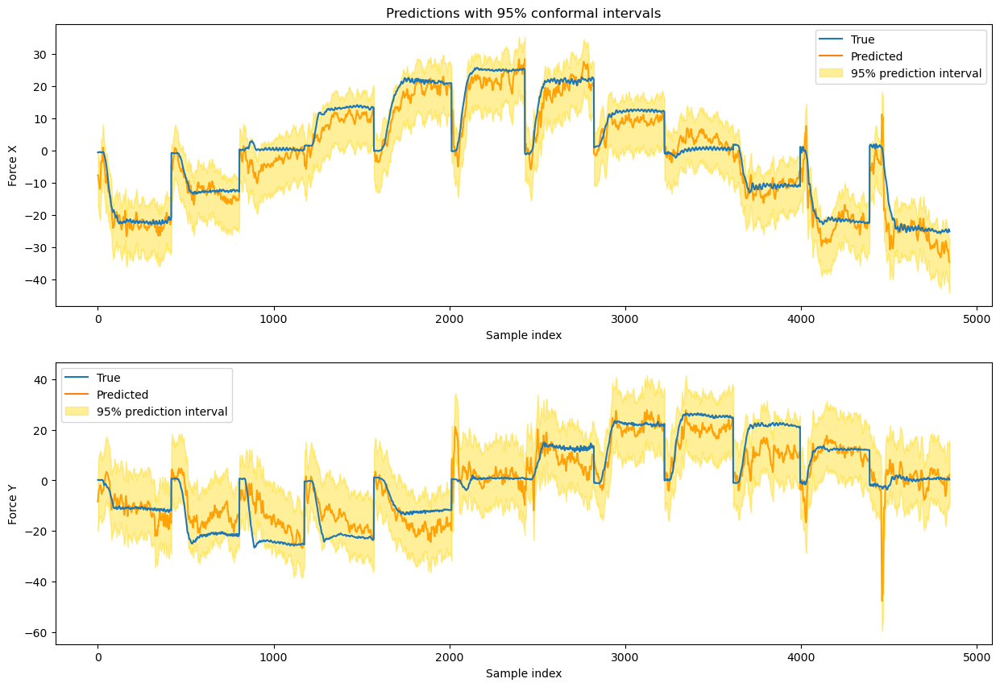

In [121]:
lower_x, upper_x = cv_residual_bootstrap(
    Ridge(), X_tr_poly, y_trval_tf.values[:,0], folds_raw, X_te_poly,
    n_boot=5000, alpha=0.05
)
lower_y, upper_y = cv_residual_bootstrap(
    Ridge(), X_tr_poly, y_trval_tf.values[:,1], folds_raw, X_te_poly,
    n_boot=5000, alpha=0.05
)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 10))

x_axis = np.arange(len(y_te_tf))

ax1.plot(y_te_tf.values[:,0], label='True')
ax1.plot(pred_te2[:, 0], label='Predicted', zorder=1)
ax1.fill_between(np.arange(len(pred_te2)), lower_x, upper_x, alpha=0.4, label='95% prediction interval', color='gold')
ax1.set_xlabel('Sample index')
ax1.set_ylabel('Force X')
ax1.set_title('Predictions with 95% conformal intervals')
ax1.legend()

ax2.plot(y_te_tf.values[:,1], label='True')
ax2.plot(pred_te2[:, 1], label='Predicted', zorder=1)
ax2.fill_between(np.arange(len(pred_te2)), lower_y, upper_y, alpha=0.4, label='95% prediction interval', color='gold')
ax2.set_xlabel('Sample index')
ax2.set_ylabel('Force Y')
ax2.legend();

#### Time-Frequency features + Feature Selection

In [122]:
from sklearn.inspection import permutation_importance

def PFI_feature_selection(estimator, X, y,
                        n_repeats: int = 30,
                        random_state: int = 0,
                        scoring=None,
                        threshold: float = 0.0,
                        top_k: int = None,
                        return_importances: bool = False):
    
    if isinstance(X, pd.DataFrame):
        feature_names = X.columns.tolist()
    else:
        feature_names = [f"x{i}" for i in range(X.shape[1])]

    result = permutation_importance(estimator, X, y,
                                    n_repeats=n_repeats,
                                    random_state=random_state,
                                    scoring=scoring,
                                    n_jobs=-1)

    importances = pd.Series(result.importances_mean, index=feature_names)
    importances = importances.sort_values(ascending=False)

    if top_k is None:
        selected = importances[importances > threshold].index.tolist()
    else:
        selected = importances.head(top_k).index.tolist()

    if return_importances:
        return selected, importances
    return selected

In [123]:
best_d, best_score =   1, float("inf")
k = 100
for d in range(1, 2):
        d_rmse = 0
        d_r2 = 0
        for i, (tr_idxs, val_idxs) in enumerate(folds_tf):
            X_tr, X_val = X_trval_tf.iloc[tr_idxs], X_trval_tf.iloc[val_idxs]
            y_tr, y_val = y_trval_tf.iloc[tr_idxs, 1], y_trval_tf.iloc[val_idxs, 1]
                
            poly = PolynomialFeatures(degree=d, include_bias=False)
            X_tr_poly = poly.fit_transform(X_tr)
            X_val_poly = poly.transform(X_val)
            
            robust = RobustScaler()
            X_tr_poly_scaled = pd.DataFrame(robust.fit_transform(X_tr_poly), columns=poly.get_feature_names_out())
            X_val_poly_scaled = pd.DataFrame(robust.transform(X_val_poly), columns=poly.get_feature_names_out())
            # pfi_feats = PFI_feature_selection(LinearRegression().fit(X_tr_poly_scaled, y_tr), X_tr_poly_scaled, y_tr, scoring="neg_root_mean_squared_error", top_k=k)
            
            from sklearn.feature_selection import SelectKBest, f_regression

            selector = SelectKBest(score_func=f_regression, k=k)
            X_tr_sel = selector.fit_transform(X_tr_poly_scaled, y_tr)
            X_val_sel = selector.transform(X_val_poly_scaled)


            print(f"Slect K Best finished! Selected {k} features.")
            lr = LinearRegression().fit(X_tr_sel, y_tr)
            
            tr_preds = lr.predict(X_tr_sel)
            y_preds = lr.predict(X_val_sel)
            fold_rmse = root_mean_squared_error(y_val, y_preds)
            fold_r2 = r2_score(y_val, y_preds)
            
            print(f"Degree {d} - fold {i+1}   |   Train RMSE: {root_mean_squared_error(y_tr, tr_preds)}   |   Train R^2: {r2_score(tr_preds, y_tr)}   |   Valid RMSE: {fold_rmse}   |   Valid R^2: {fold_r2}")
            d_rmse+=fold_rmse
            d_r2+=fold_r2
            
        d_rmse /= len(folds_tf)
        d_r2 /= len(folds_tf)
        print(f"\nd={d} Mean Valid RMSE: {d_rmse}   |   Mean Valid R^2: {d_r2}")
        print("\n\n")
        
        if d_rmse < best_score:
            best_score = d_rmse
            best_d = d
            
print(f"Best found score: {best_score} with d={best_d}")

Slect K Best finished! Selected 100 features.
Degree 1 - fold 1   |   Train RMSE: 3.4264694552156483   |   Train R^2: 0.9502642575472684   |   Valid RMSE: 6.7243872564620695   |   Valid R^2: 0.8149750419531328
Slect K Best finished! Selected 100 features.
Degree 1 - fold 2   |   Train RMSE: 3.721967390633395   |   Train R^2: 0.9404266199193894   |   Valid RMSE: 5.461438238913705   |   Valid R^2: 0.8792361296476622
Slect K Best finished! Selected 100 features.
Degree 1 - fold 3   |   Train RMSE: 3.5459123419897143   |   Train R^2: 0.9461057442146362   |   Valid RMSE: 5.217993538908831   |   Valid R^2: 0.8904521953697437

d=1 Mean Valid RMSE: 5.801273011428202   |   Mean Valid R^2: 0.8615544556568463



Best found score: 5.801273011428202 with d=1


In [124]:
scores_df = pd.DataFrame({
    'Feature': X_trval_tf.columns,
    'Score': selector.scores_
})

scores_df_sorted = scores_df.sort_values(by='Score', ascending=False)
scores_df_sorted.head(10)

,Feature,Score
28,lTRI_rms,6570.779406
27,lTRI_mean,6568.812683
4,lTRI,6051.585453
33,BRA_rms,5170.829433
32,BRA_mean,5145.268433
99,lTRI_band_2_5_power,4670.337907
5,BRA,4654.920777
97,lTRI_total_power,4646.186032
98,lTRI_band_0_0.5_power,4635.509884
31,lTRI_wl,4390.160650


#### Raw NN

In previous approaches, we used handcrafted features derived from raw signals or used the signals directly as predictors.This method depends heavily on manual feature engineering. An alternative is to let the model learn relevant features on its own.

Given that signals are sequences of data points, they naturally can be modelled as time series, for example with Recurrent Neural Networks (RNNs), such as LSTM networks. Additionally, since nearby points in a signal carry local patterns, we can treat the signal as a one-dimensional image and apply Convolutional Neural Networks (CNNs), which perform local feature extraction.

To leverage both local pattern detection and temporal dependencies, we construct a hybrid 1D CNN-LSTM architecture. The network starts with one or more 1D convolutional layers that extract localized features from the input signal, followed by batch normalization for regularization and stability, and max pooling to downsample the signal. These blocks can be stacked to detect increasingly abstract features.

The resulting feature maps are then passed into an LSTM layer to capture the temporal information across time steps. Dropout is added for regularization and also enables Monte Carlo uncertainty estimation when activate at inference time. Finally, a fully connected layer uses the learned representation to create two outputs: predicted force X and force Y.


We'll use Keras.

In [125]:
import tensorflow as tf
from tensorflow.keras import layers as L, backend as K, callbacks

In [252]:
def build_emg_cnn_lstm(input_length, n_channels, 
                       cnn_filters=[32, 64], 
                       kernel_sizes=[5,5], 
                       pool_sizes=[2,2], 
                       lstm_units=128, 
                       dense_units=64, 
                       dropout_rate=0.3):
    
    inp = L.Input(shape=(input_length, n_channels))
    
    x = inp
    for filters, ksz, psz in zip(cnn_filters, kernel_sizes, pool_sizes):
        x = L.Conv1D(filters, ksz, activation='relu', padding='same')(x)
        x = L.BatchNormalization()(x)
        x = L.MaxPooling1D(psz)(x)
    
    x = L.LSTM(lstm_units, return_sequences=False)(x)
    x = L.Dropout(dropout_rate)(x, training=True)
    
    x = L.Dense(dense_units, activation='relu')(x)
    out = L.Dense(2, activation='linear')(x)
    
    model = tf.keras.models.Model(inputs=inp, outputs=out)
    model.compile(optimizer='adam', loss='mse', metrics=["r2_score"])
    return model


The input to the model consists of 50 time steps (0.5 seconds) of 7 muscle signals. 0.5 seconds is short, however we have 4 seconds of data for each combination (which is the only way to preserve the sequential nature), thus using something like 2 seconds would reduce the sets a lot.

In [253]:
def create_windows_with_labels(df, window_size=200, step=50, emg_cols=None, force_cols=['force']):
    X, y, repetitions, directions = [], [], [], []
    emg_cols = emg_cols or [col for col in df.columns if 'EMG' in col]

    for (rep, direct), group in df.groupby(['repetition', 'direction']):
        emg = group[emg_cols].values
        force = group[force_cols].values

        for i in range(0, len(emg) - window_size, step):
            X.append(emg[i:i+window_size])
            y.append(force[i+window_size-1])
            repetitions.append(rep)
            directions.append(direct)

    return np.array(X), np.array(y), np.array(repetitions), np.array(directions)

In [254]:
X, y, reps, dirs = create_windows_with_labels(merged_df, emg_cols=muscle_fields,force_cols=["force_x", "force_y"], step=1, window_size=50)

X.shape, y.shape

((18087, 50, 7), (18087, 2))

In [255]:
X_tr = X[reps!=3]
y_tr = y[reps!=3]

X_te = X[reps==3]
y_te = y[reps==3]

reps_tr = np.array([x for x in reps if x!=3])
X_tr.shape, y_tr.shape, X_te.shape, y_te.shape 

((13842, 50, 7), (13842, 2), (4245, 50, 7), (4245, 2))

Using half a second we are able to obtain similar number of observations to the previous sets.
We'll perform the sae cross-validation as we did earlier, training one model per combination.

In [256]:
kfold = GroupKFold(n_splits=3)

In [257]:
for t, v in kfold.split(X_tr, y_tr, reps_tr):
    print(f"Train repetitions: {np.unique(reps_tr[t])}, Val repetitions: {np.unique(reps_tr[v])}")
    print()

Train repetitions: [0 2], Val repetitions: [1]

Train repetitions: [1 2], Val repetitions: [0]

Train repetitions: [0 1], Val repetitions: [2]



The model is trained using the Adam optimizer with a learning rate scheduler that reduces the learning rate on plateau, helping the training converge smoothly. A batch size of 64 is used to balance computational efficiency and gradient stability. Early stopping is applied during training to prevent overfitting by monitoring the validation loss and halting training when it stops improving.

In [258]:
fold = 1
EPOCHS=100
BATCH_SIZE=64

models=[]
histories = []

for train_id, val_id in kfold.split(X_tr, y_tr, reps_tr):
    print(f"\n# Fold {fold}/{3}")

    model = build_emg_cnn_lstm(input_length=X_tr.shape[1], n_channels=X_tr.shape[2])

    cbs = [
        callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True, verbose=1),
        callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6, verbose=1),
    ]

    history_tr = model.fit(
        X_tr[train_id], y_tr[train_id],
        validation_data=(X_tr[val_id], y_tr[val_id]),
        epochs=EPOCHS,
        batch_size=BATCH_SIZE,
        callbacks=cbs,
        verbose=1, 
    )

    model.save(f"models/cnn_lstm_fold{fold}.h5")
    models.append(model)
    histories.append(history_tr)

    fold += 1

    K.clear_session()


# Fold 1/3
Epoch 1/100
137/137 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step - loss: 116.5410 - r2_score: 0.5849 - val_loss: 221.2888 - val_r2_score: 0.1737 - learning_rate: 0.0010
Epoch 2/100
137/137 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 6.0546 - r2_score: 0.9783 - val_loss: 172.7382 - val_r2_score: 0.3558 - learning_rate: 0.0010
Epoch 3/100
137/137 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 4.6544 - r2_score: 0.9833 - val_loss: 93.7772 - val_r2_score: 0.6506 - learning_rate: 0.0010
Epoch 4/100
137/137 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 4.1400 - r2_score: 0.9851 - val_loss: 30.8187 - val_r2_score: 0.8852 - learning_rate: 0.0010
Epoch 5/100
137/137 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 3.4481 - r2_score: 0.9878 - val_loss: 5.3404 - val_r2_score: 0.9801 - learning_rate: 0.0010
Epoch 6/100
137/137 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 3.0167 - r2_score: 0.9892 - val_loss: 6.3098 - val_r2_score: 0.9765 - learning_rate: 0.0010
Epoch 7/100
137/137 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - 


# Fold 2/3
Epoch 1/100
147/147 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - loss: 104.4891 - r2_score: 0.6182 - val_loss: 237.4605 - val_r2_score: 0.1474 - learning_rate: 0.0010
Epoch 2/100
147/147 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 5.6983 - r2_score: 0.9792 - val_loss: 210.7383 - val_r2_score: 0.2433 - learning_rate: 0.0010
Epoch 3/100
147/147 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - loss: 4.4175 - r2_score: 0.9840 - val_loss: 145.2892 - val_r2_score: 0.4783 - learning_rate: 0.0010
Epoch 4/100
147/147 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 3.8142 - r2_score: 0.9861 - val_loss: 26.2294 - val_r2_score: 0.9058 - learning_rate: 0.0010
Epoch 5/100
147/147 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 3.0475 - r2_score: 0.9889 - val_loss: 11.5464 - val_r2_score: 0.9586 - learning_rate: 0.0010
Epoch 6/100
147/147 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 3.0929 - r2_score: 0.9887 - val_loss: 9.3885 - val_r2_score: 0.9663 - learning_rate: 0.0010
Epoch 7/100
147/147 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step 


# Fold 3/3
Epoch 1/100
150/150 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step - loss: 108.9031 - r2_score: 0.6005 - val_loss: 247.9892 - val_r2_score: 0.1203 - learning_rate: 0.0010
Epoch 2/100
150/150 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - loss: 6.3423 - r2_score: 0.9766 - val_loss: 242.9917 - val_r2_score: 0.1380 - learning_rate: 0.0010
Epoch 3/100
150/150 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - loss: 4.6733 - r2_score: 0.9830 - val_loss: 178.2030 - val_r2_score: 0.3679 - learning_rate: 0.0010
Epoch 4/100
150/150 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - loss: 4.0820 - r2_score: 0.9850 - val_loss: 36.2214 - val_r2_score: 0.8715 - learning_rate: 0.0010
Epoch 5/100
150/150 ━━━━━━━━━━━━━━━━━━━━ 3s 21ms/step - loss: 3.8658 - r2_score: 0.9859 - val_loss: 3.7164 - val_r2_score: 0.9868 - learning_rate: 0.0010
Epoch 6/100
150/150 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - loss: 3.5921 - r2_score: 0.9868 - val_loss: 9.8162 - val_r2_score: 0.9652 - learning_rate: 0.0010
Epoch 7/100
150/150 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step -

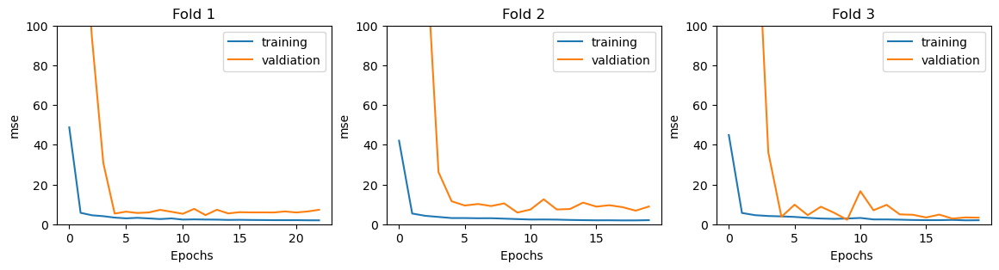

In [259]:
fig, axs = plt.subplots(1,3, figsize=(14, 3))

for i in range(3):
    axs[i].plot(histories[i].history["loss"], label="training")
    axs[i].plot(histories[i].history["val_loss"], label="valdiation")
    axs[i].set_ylim(0, 100)
    axs[i].set_ylabel("mse"), axs[i].set_xlabel("Epochs ")
    axs[i].set_title(f"Fold {i+1}"),axs[i].legend()

Notably, the training MSE drops early in the epochs and stabilizes at near zero, suggesting effective learning. Tthe validation MSE follows a similar downward trend initially but then exhibits fluctuations, which could indicate varying performance. Still it's hard to consider this overfitting as the validation performance is so good. An higher regularization rate maybe would help.

After cross-validation we usually train a model on the train and validation data to then make the final test prediction. Here it's unoptimal because early stopping and scheduler work to avoid overfitting by looking at the validation loss. We could do a naive split, but the repetitions won't be separated  and it wouldn't mean much. Instead we'll train the model for fewer epochs and compare it with the others.

In [260]:
model = build_emg_cnn_lstm(input_length=X.shape[1], n_channels=X.shape[2])
model.summary()

history = model.fit(
        X_tr, y_tr,
        epochs=25+5,
        batch_size=BATCH_SIZE,
        # callbacks=cbs,
        verbose=1, 
    )

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 50, 7)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d (Conv1D)                 │ (None, 50, 32)         │         1,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 50, 32)         │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d (MaxPooling1D)    │ (None, 25, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_1 (Conv1D)               │ (None, 25, 64)         │        10,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 25, 64)         │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_1 (MaxPooling1D)  │ (None, 12, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ (None, 128)            │        98,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 119,042 (465.01 KB)

 Trainable params: 118,850 (464.26 KB)

 Non-trainable params: 192 (768.00 B)

Epoch 1/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 6s 13ms/step - loss: 88.1204 - r2_score: 0.6824
Epoch 2/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - loss: 5.5924 - r2_score: 0.9796
Epoch 3/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - loss: 4.9198 - r2_score: 0.9822
Epoch 4/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - loss: 4.0482 - r2_score: 0.9854
Epoch 5/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - loss: 3.3919 - r2_score: 0.9877
Epoch 6/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - loss: 3.0921 - r2_score: 0.9888
Epoch 7/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - loss: 3.0686 - r2_score: 0.9888
Epoch 8/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 3s 15ms/step - loss: 2.9735 - r2_score: 0.9893
Epoch 9/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - loss: 2.7034 - r2_score: 0.9902
Epoch 10/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - loss: 2.4064 - r2_score: 0.9913
Epoch 11/30
217/217 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - loss: 2.5727 - r2_score: 0.9907
Epoch 12/30
217/217 ━━━━━━━━━━━━━━━━━━━━

In [261]:
te_pred = model.predict(X_te)
mods_pred = [mod.predict(X_te) for mod in models]

133/133 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
133/133 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
133/133 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
133/133 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


In [262]:
rmse = root_mean_squared_error(y_te, te_pred)
r2 = r2_score(y_te, te_pred)

print(f"Full model\nRMSE: {rmse}\nR^2: {r2}")

for i, pred in enumerate(mods_pred):
    print()
    rmse = root_mean_squared_error(y_te, pred)
    r2 = r2_score(y_te, pred)

    print(f"Model (Fold {i+1})\nRMSE: {rmse}\nR^2: {r2}")

Full model
RMSE: 2.390331674199609
R^2: 0.9793864818492305

Model (Fold 1)
RMSE: 1.724049562206218
R^2: 0.9891422022950804

Model (Fold 2)
RMSE: 2.470827754719688
R^2: 0.9764842313680457

Model (Fold 3)
RMSE: 2.8942564364075416
R^2: 0.9702066144359411


They have very high scores, with Fold 1 model almost hitting 0.99. The full model is a bit worse, but with tuning we expect it to be the best one as it's seeing more information.

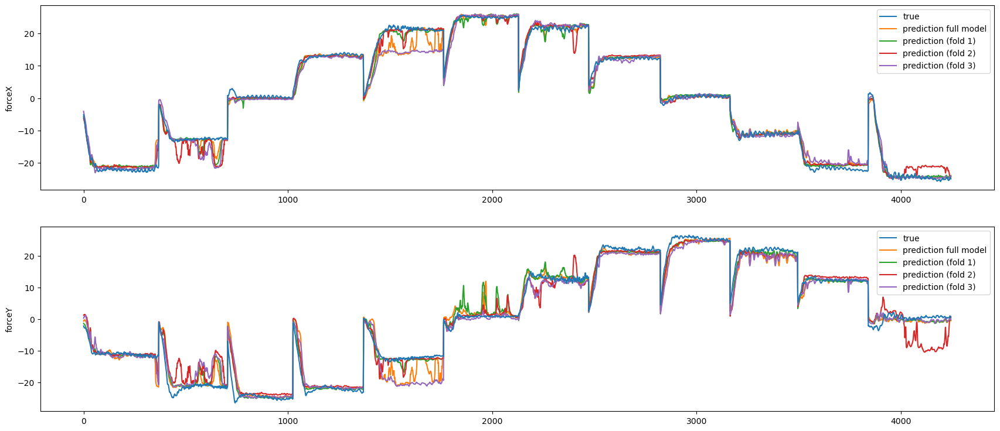

In [263]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(21, 9))

x_axis = np.arange(len(y_te))

ax1.set_ylabel("forceX")
ax1.plot(x_axis, y_te[:, 0], label="true")
ax1.plot(x_axis, te_pred[:,0], label="prediction full model", zorder=1)
for i in range(3):
    ax1.plot(x_axis, mods_pred[i][:, 0], label=f"prediction (fold {i+1})", zorder=1)
ax1.legend()

ax2.set_ylabel("forceY")
ax2.plot(x_axis, y_te[:, 1], label="true")
ax2.plot(x_axis, te_pred[:,1], label="prediction full model", zorder=1)
for i in range(3):
    ax2.plot(x_axis, mods_pred[i][:, 1], label=f"prediction (fold {i+1})", zorder=1)
ax2.legend();

They follow the curve quite closely although certain segments seem quite hard to model even for the NNs. Force Y in general is a lot harder to follow. 

Next we can use Montecarlo dropout to get the prediction interval.

This works by activating Dropout (which turns off p% of the neurons of the previous layer at each forward pass randomly) also during testing phase. Each time we run the model it's like we are using a slighly different one, so the result will be different. From it we can simply use the variance to get an interval.

In [296]:
def mc_dropout_predict(model, X_input, n_iter=100):
    preds = np.array([model(X_input, training=True).numpy().squeeze() for _ in range(n_iter)])
    return preds.mean(axis=0), preds.std(axis=0)

In [266]:
y_mean, y_std = mc_dropout_predict(model, X_te, n_iter=100)

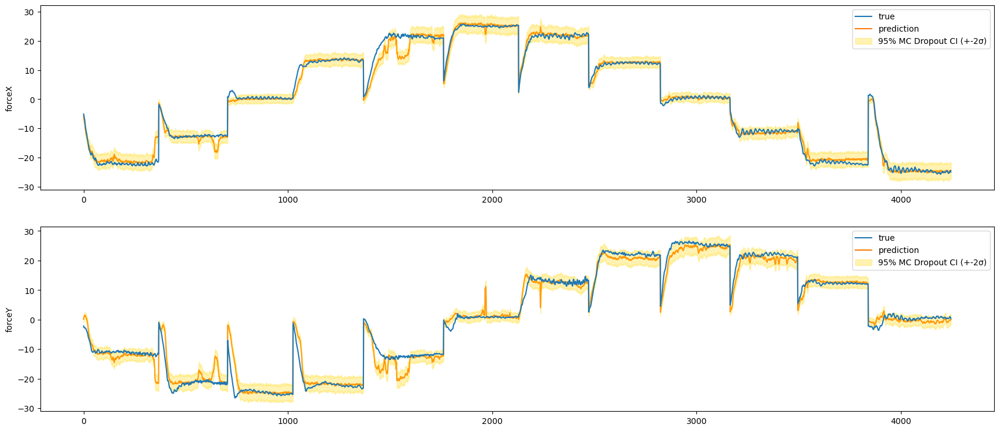

In [278]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(21, 9))

x_axis = np.arange(len(y_te))

ax1.set_ylabel("forceX")
ax1.plot(x_axis, y_te[:, 0], label="true")
ax1.plot(x_axis, y_mean[:, 0], label='prediction', zorder=1)
ax1.fill_between(range(len(y_mean)), y_mean[:,0] - 2*y_std[:,0], y_mean[:,0] + 2*y_std[:,0],
                 alpha=0.3, label='95% MC Dropout CI (+-2σ)', color="gold")
ax1.legend()

ax2.set_ylabel("forceY")
ax2.plot(x_axis, y_te[:, 1], label="true")
ax2.plot(x_axis, y_mean[:, 1], label='prediction', zorder=1)
ax2.fill_between(range(len(y_mean)), y_mean[:, 1] - 2*y_std[:, 1], y_mean[:, 1] + 2*y_std[:, 1],
                 alpha=0.3, label='95% MC Dropout CI (+-2σ)', color="gold")
ax2.legend();


The interval is quite narrow. This can be a symptom of an overconfident model, but we know that the model is good, so such an interval is actually a good thing. Worth to note that we have a single dropout layer, the interval size would increase along with the amount of dropout (and p) used.

# Conclusion


 **Preprocessing**:  
   - Bandpass/notch filtering improved SNR by a small amount 17.68 to 18.37.  
   - Downsampling enabled alignment of EMG and force signals without losing predictive power.  

**Model Performance**:  
   - **Linear Regression / Ridge (Poly-3)**: Achieved test R² = 0.90, but struggled with high-frequency noise.  
   - Residual analysis confirmed near-normal errors but heteroskedasticity in predictions.  
   - **CNN-LSTM**: Much higher scores by capturing temporal dependencies.  
   - The CNN-LSTM approach demonstrates the potential of deep learning for EMG analysis, while linear models remain valuable for interpretability.  

**Feature Importance and Interpretability**:  
   - **Triceps (`lTRI`)** and **deltoids (`aDEL`/`pDEL`)** were top contributors to force prediction.  
   - Extracted features and raw signals yielded similar results in linear models, the polynomial features added predictive power.  
   - PCA revealed directional activation patterns (e.g., `aDEL` peaks at 180° for backward force).  

## Practical Implications  
- **Prosthetics/Rehabilitation**: Models could enable real-time EMG-driven force control.  
- **Biomechanics**: Insights into muscle coordination during directional tasks.  